# Project Title: Food Recognition

## Problem Statement 
- Food classification is a complex computer vision problem focused on identifying the type of food from an image.
- The Food-101 dataset, with its 101,000 images spanning 101 food categories photographed in a variety of lighting conditions, angles, and presentations, encapsulates these real-world complexities.
- The primary challenge is to develop a deep learning-based model that can accurately predict the food category for any given image, despite substantial visual diversity within each class.  

## Motivation

- With the rise of digital health monitoring and the increasing focus on Restaurant automation, automated food recognition has become an important area in computer vision.
- Image Classification: Identifying which image belongs to which class.
- One of the core tasks in computer vision
- Broad array of applications:
    - Menu digitization
    - Dietary monitoring
    - Self-Checkout
    - Health Tracking
    - QC of Food  

## Data Sources

We use the **Food-101** dataset for this project.

> **Citation**:
> 
> Bossard, Lukas, Guillaumin, Matthieu, and Van Gool, Luc.  
> *Food-101 – Mining Discriminative Components with Random Forests.*  
> In: European Conference on Computer Vision (ECCV), 2014.

**Dataset Overview**:
- **Total Images**: 101,000
- **Number of Classes**: 101 food categories
- **Training/Testing Split**: 750 training and 250 testing images per class
- **Image Size**: Original images are 512×512, but commonly resized to 224×224 for training
- **Access**: Available from the [official ETH Zurich website](https://data.vision.ee.ethz.ch/cvl/datasets_extra/food-101/)

The dataset contains a wide variety of food categories, making it a challenging and diverse benchmark for fine-grained image classification tasks.

## Exploratory Analysis of Data 

### Preprocessing Steps
- After loading the data from the dataset,we performed
    1. Label Encoding - Categorical food labels are converted into numerical representations, enabling efficient processing by machine learning algorithms
    2. Image paths and corresponding labels are extracted from metadata files and organized into structured Pandas DataFrames for training and testing.
    3. Dataset Splitting - The prepared datasets are shuffled for randomness and verified, confirming the 675 training , 75 validation and 250 test images per category split.


The images are preprocessed using standard PyTorch `transforms.Compose()` for data augmentation and normalization.

- **Training transforms**:
  - Random Resized Crop (224×224)
  - Random Horizontal Flip
  - Convert to Tensor
  - Normalize using ImageNet mean and std

- **Validation/Test transforms**:
  - Resize to 256
  - Center Crop (224×224)
  - Convert to Tensor
  - Normalize

#### Preprocessing

In [1]:
# Importing Libraries
import pandas as pd
import numpy as np
from sklearn.utils import shuffle
from sklearn.metrics import f1_score, precision_score, accuracy_score, classification_report
from PIL import Image
import torch
import matplotlib.pyplot as plt
import torch.nn as nn
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from sklearn.model_selection import train_test_split
import torchinfo
import os
from tqdm import tqdm
from pathlib import Path
import seaborn as sns
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score, accuracy_score
from torchvision.models import resnet50
from torch.serialization import add_safe_globals
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

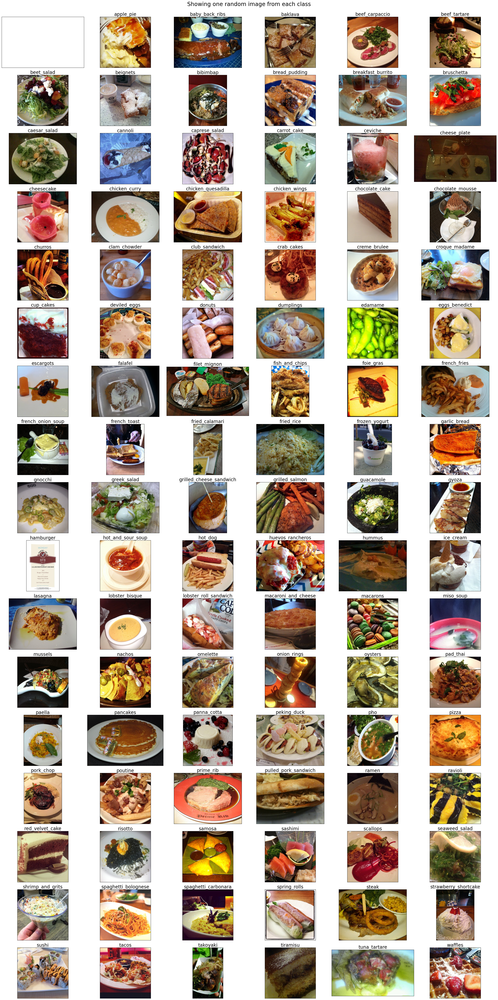

In [2]:
rows = 17
cols = 6
fig, ax = plt.subplots(rows, cols, figsize=(30,60))
fig.suptitle("Showing one random image from each class", y=1,fontsize=24)
data_dir = "food-101/images/"
foods_sorted = sorted(os.listdir(data_dir))
food_id = 0
for i in range(rows):
  for j in range(cols):
    try:
      food_selected = foods_sorted[food_id] 
      food_id += 1
    except:
      break
    if food_selected == '.DS_Store':
        continue
    food_selected_images = os.listdir(os.path.join(data_dir,food_selected)) # returns the list of all files present in each food category
    food_selected_random = np.random.choice(food_selected_images) 
    img = plt.imread(os.path.join(data_dir,food_selected, food_selected_random))
    ax[i][j].imshow(img)
    ax[i][j].set_title(food_selected, pad = 2,fontsize=20)
    
plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()

<div class="alert alert-block alert-info">
<b> DEVICE CHECKING </b>
</div>

In [3]:
print("PyTorch version:", torch.__version__)
print("MPS available:", torch.backends.mps.is_available())
print("MPS built:", torch.backends.mps.is_built())

PyTorch version: 2.7.1
MPS available: True
MPS built: True


In [4]:
if torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Using Apple Silicon (MPS) device.")
elif torch.cuda.is_available(): # For Intel Macs with NVIDIA GPUs
    device = torch.device("cuda")
    print("Using CUDA device.")
else:
    device = torch.device("cpu")
    print("Using CPU device.")


Using Apple Silicon (MPS) device.


In [5]:
# Base directory of data
data_dir = Path('food-101')
meta_dir = data_dir / 'meta'
images_dir = data_dir / 'images'

In [6]:
classes = open('food-101/meta/classes.txt','r').read().splitlines()

<div class="alert alert-block alert-info">
<b> Label Encoding </b>
</div>

In [7]:
class Label_encoder:
    def __init__(self, labels):
        self.labels = {label: idx for idx, label in enumerate(labels)}

    def get_label(self, idx):
        return list(self.labels.keys())[idx]

    def get_idx(self, label):
        return self.labels.get(label)

encoder = Label_encoder(classes)
encoder.get_label(0), encoder.get_idx( encoder.get_label(0) )

for i in range(len(classes)):
    print(encoder.get_label(i), encoder.get_idx( encoder.get_label(i) ))

apple_pie 0
baby_back_ribs 1
baklava 2
beef_carpaccio 3
beef_tartare 4
beet_salad 5
beignets 6
bibimbap 7
bread_pudding 8
breakfast_burrito 9
bruschetta 10
caesar_salad 11
cannoli 12
caprese_salad 13
carrot_cake 14
ceviche 15
cheesecake 16
cheese_plate 17
chicken_curry 18
chicken_quesadilla 19
chicken_wings 20
chocolate_cake 21
chocolate_mousse 22
churros 23
clam_chowder 24
club_sandwich 25
crab_cakes 26
creme_brulee 27
croque_madame 28
cup_cakes 29
deviled_eggs 30
donuts 31
dumplings 32
edamame 33
eggs_benedict 34
escargots 35
falafel 36
filet_mignon 37
fish_and_chips 38
foie_gras 39
french_fries 40
french_onion_soup 41
french_toast 42
fried_calamari 43
fried_rice 44
frozen_yogurt 45
garlic_bread 46
gnocchi 47
greek_salad 48
grilled_cheese_sandwich 49
grilled_salmon 50
guacamole 51
gyoza 52
hamburger 53
hot_and_sour_soup 54
hot_dog 55
huevos_rancheros 56
hummus 57
ice_cream 58
lasagna 59
lobster_bisque 60
lobster_roll_sandwich 61
macaroni_and_cheese 62
macarons 63
miso_soup 64
mussels

<div class="alert alert-block alert-info">
<b> Dataframe preparation and Dataset Spliting</b>
</div>

In [8]:
def prep_df(path):
    try:
        with open(path, 'r') as f:
            array = f.read().splitlines()
    except FileNotFoundError:
        print(f"Error: '{path.name}' not found at {path}. Please ensure the food-101 dataset is correctly structured.")
        return pd.DataFrame() 

    data = []
    for entry in array:
        parts = entry.split('/') # since every row is in the format like apple_pie/1028787
        if len(parts) == 2:
            label = parts[0]
            img_id = parts[1]
            full_path = images_dir / f"{label}/{img_id}.jpg"
            data.append({'label': label, 'path': str(full_path)})
        else:
            print(f"Unexpected format in metadata file: {entry}")

    df = pd.DataFrame(data)
    df = shuffle(df, random_state=42)
    return df

train_imgs = prep_df(meta_dir / 'train.txt')
test_imgs = prep_df(meta_dir / 'test.txt')

if train_imgs.empty or test_imgs.empty:
    print("Exiting due to missing data files.")
    exit() 

print(f"\nTrain images shape: {train_imgs.shape}") # 101 classes * 750 training images per class
print(f"Test images shape: {test_imgs.shape}") # 101 classes * 250 testing images per class


Train images shape: (75750, 2)
Test images shape: (25250, 2)


In [9]:
# Ensure 'train_imgs' is your DataFrame containing 'label' column
train_df, val_df = train_test_split(
    train_imgs,
    test_size=0.1,
    stratify=train_imgs['label'],
    random_state=42
)

# Reset indices (optional but often helpful)
train_df = train_df.reset_index(drop=True)
val_df = val_df.reset_index(drop=True)

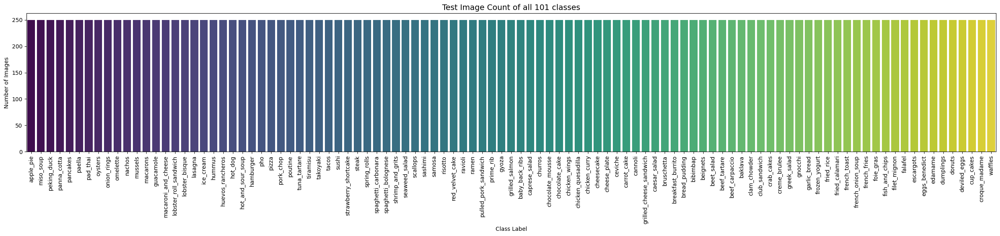

In [10]:
label_counts = test_imgs.groupby("label").count().iloc[:, 0].sort_values(ascending=False)

# Convert to DataFrame for Seaborn
label_df = pd.DataFrame({
    "label": label_counts.index,
    "count": label_counts.values
})

# Plot using seaborn
plt.figure(figsize=(25, 6))  # Wide to fit all 101 class names
sns.barplot(data=label_df, x="label", y="count", hue="label", palette="viridis", legend=False)

plt.title("Test Image Count of all 101 classes", fontsize=14)
plt.xlabel("Class Label")
plt.ylabel("Number of Images")
plt.xticks(rotation=90)  # Rotate to avoid overlap
plt.tight_layout()
plt.show()

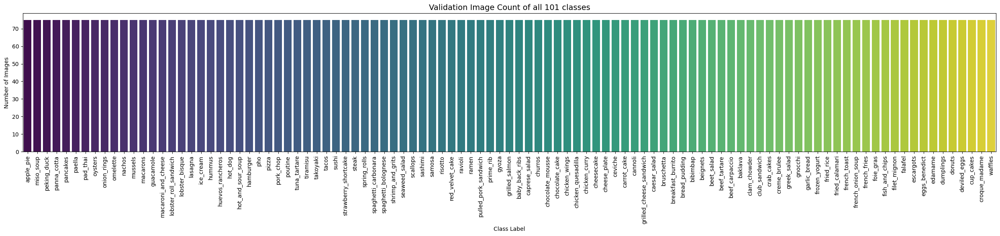

In [11]:
label_counts = val_df.groupby("label").count().iloc[:, 0].sort_values(ascending=False)

# Convert to DataFrame for Seaborn
label_df = pd.DataFrame({
    "label": label_counts.index,
    "count": label_counts.values
})

# Plot using seaborn
plt.figure(figsize=(25, 6))  # Wide to fit all 101 class names
sns.barplot(data=label_df, x="label", y="count", hue="label", palette="viridis", legend=False)

plt.title("Validation Image Count of all 101 classes", fontsize=14)
plt.xlabel("Class Label")
plt.ylabel("Number of Images")
plt.xticks(rotation=90)  # Rotate to avoid overlap
plt.tight_layout()
plt.show()

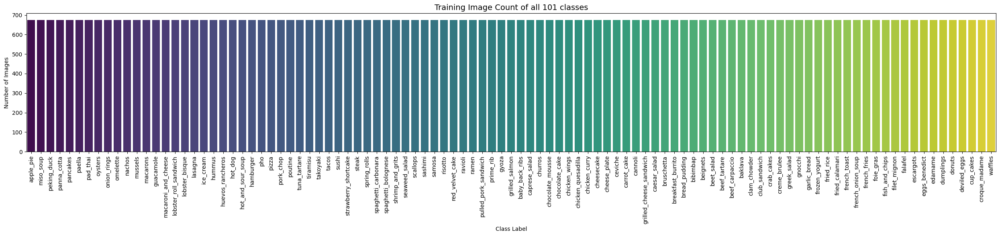

In [12]:
label_counts = train_df.groupby("label").count().iloc[:, 0].sort_values(ascending=False)

# Convert to DataFrame for Seaborn
label_df = pd.DataFrame({
    "label": label_counts.index,
    "count": label_counts.values
})

# Plot using seaborn
plt.figure(figsize=(25, 6))  # Wide to fit all 101 class names
sns.barplot(data=label_df, x="label", y="count", hue="label", palette="viridis", legend=False)

plt.title("Training Image Count of all 101 classes", fontsize=14)
plt.xlabel("Class Label")
plt.ylabel("Number of Images")
plt.xticks(rotation=90)  # Rotate to avoid overlap
plt.tight_layout()
plt.show()

#### Challenging Aspects of the Dataset

#### **Diversity**
The dataset contains **significant variation in presentation, background, lighting, and camera angles**, which makes it more realistic and challenging.

> For example:
> - Each image of the same dish varies in plating style, garnishing, and color tone.
> - Some images contain **irrelevant scenes**, like the server, cutlery, drinks , restaurant interiors, or background clutter, which introduces noise into feature learning.

#### **Intra-Class Variability**
- **Same dish can appear drastically different** in different images due to ingredient choices, lighting, and presentation.
- Example: The "hamburger" class includes a variety of buns, sauces, toppings, and arrangements.

####  **Inter-Class Similarity**
- Several food items share **visual similarities**, which leads to confusion during classification.
- Example:
  - Many dishes include a **fried egg on top**, which can mislead the model into grouping unrelated classes.
  - Dishes like **tuna_tartare and beef_tartare** differ only in taste ,and looks similar in Garnish and Color making them visually difficult to separate.


#### Image Transformations

In [13]:
# Training transforms
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Testing/Validation transforms
test_transforms = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])


<div class="alert alert-block alert-info">
<b> Custom Dataset and DataLoader Initialization</b>
</div>

In [14]:
class Food101(Dataset):
    def __init__(self, dataframe, transform=None):
        self.dataframe = dataframe
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        img_path = self.dataframe.path.iloc[idx]
        try:
            image = Image.open(img_path).convert('RGB')
        except Exception as e:
            print(f"Error opening image {img_path}: {e}. Returning a dummy image.")
            image = Image.new('RGB', (224, 224), (0, 0, 0)) # Return a black image

        label_name = self.dataframe.label.iloc[idx]
        label = encoder.get_idx(label_name)
        if label is None:
            print(f"Warning: Label '{label_name}' not found in encoder. Using default label 0 for sample {idx}.")
            label = 0 # Assign a default label or handle as per your policy

        if self.transform:
            image = self.transform(image)

        return image, label

train_dataset = Food101(train_df, transform=train_transforms)
val_dataset = Food101(val_df, transform=test_transforms)
test_dataset = Food101(test_imgs, transform=test_transforms)

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=0)

In [15]:
print("\nTraining data retrieval:")
for i in range(5): 
    try:
        image, label = train_dataset[i]
        print(f"{encoder.get_label(label)}, {image.shape}")
    except Exception as e:
        print(f"Error retrieving sample {i}: {e}")


Training data retrieval:
shrimp_and_grits, torch.Size([3, 224, 224])
ice_cream, torch.Size([3, 224, 224])
gnocchi, torch.Size([3, 224, 224])
dumplings, torch.Size([3, 224, 224])
foie_gras, torch.Size([3, 224, 224])


In [16]:
print("\nTesting data retrieval:")
for i in range(5): 
    try:
        image, label = test_dataset[i]
        print(f"{encoder.get_label(label)}, {image.shape}")
    except Exception as e:
        print(f"Error retrieving sample {i}: {e}")


Testing data retrieval:
fish_and_chips, torch.Size([3, 224, 224])
chocolate_cake, torch.Size([3, 224, 224])
filet_mignon, torch.Size([3, 224, 224])
ramen, torch.Size([3, 224, 224])
pancakes, torch.Size([3, 224, 224])


## Models

#### Modern CNNs
Architectures such as **ResNet50**, **EfficientNet**, and **ConvNeXt** have been successfully applied to the Food-101 dataset. These models improve classification accuracy by:

- Leveraging **deeper and wider** network designs
- Addressing **overfitting** with better regularization and normalization techniques
- Utilizing **residual connections** (e.g., in ResNet) to preserve gradient flow during backpropagation

#### Hybrid Models
Combining **CNNs** (e.g., ResNet50) with **Vision Transformers (ViTs)** has become a powerful trend. These hybrid models:

- Capture both **local texture features** (via CNN layers)
- And **global context** (via transformer attention layers)
- Result in significantly **higher accuracy** on fine-grained datasets like Food-101


### Basemodel - RESNET50

<div class="alert alert-success">
  <h4><strong>Why Use ResNet-50 as a Baseline?</strong></h4>

  <h5>Deep Representational Power</h5>
  <p>
    ResNet-50 leverages <strong>residual connections</strong>, which help combat the <strong>vanishing gradient problem</strong>.
    This ensures that meaningful gradients flow all the way back to early layers, enabling the network to
    <strong>train deeper architectures effectively</strong>.
  </p>

  <h5>Proven Performance on ImageNet</h5>
  <p>
    As ResNet-50 was <strong>pretrained on the large-scale ImageNet dataset</strong>, it has already learned
    <strong>rich and transferable visual features</strong>. These features are particularly useful for downstream tasks like food classification,
    where textures and fine-grained details matter.
  </p>

  <h5>Efficiency and Scalability</h5>
  <p>
    ResNet-50 provides an excellent <strong>trade-off between depth, speed, and accuracy</strong>:
    <ul>
      <li>Deep enough to model complex patterns</li>
      <li>Lightweight enough for fast inference</li>
      <li>Achieves <strong>high performance</strong> without excessive computational cost</li>
    </ul>
  </p>

  <p>
    For these reasons, ResNet-50 serves as a strong and well-established <strong>baseline model</strong> for the Food-101 dataset.
  </p>
</div>



In [19]:
# Load pretrained ResNet50
weights = models.ResNet50_Weights.IMAGENET1K_V1
resnet_model = models.resnet50(weights=weights)

# Freeze all layers
for param in resnet_model.parameters():
    param.requires_grad = False

# Unfreeze last block (layer4) and classification head (fc)
for name, param in resnet_model.named_parameters():
    if 'layer4' in name or 'fc' in name:
        param.requires_grad = True

# Replace final classification head
num_classes = len(classes)
resnet_model.fc = nn.Linear(resnet_model.fc.in_features, num_classes)

# Move model to device (MPS)
resnet_model = resnet_model.to(device)

# Print summary (use input size [1, 3, 224, 224])
print("\nModel Summary:")
torchinfo.summary(resnet_model, input_size=(1, 3, 224, 224), device=device)


Model Summary:


Layer (type:depth-idx)                   Output Shape              Param #
ResNet                                   [1, 101]                  --
├─Conv2d: 1-1                            [1, 64, 112, 112]         (9,408)
├─BatchNorm2d: 1-2                       [1, 64, 112, 112]         (128)
├─ReLU: 1-3                              [1, 64, 112, 112]         --
├─MaxPool2d: 1-4                         [1, 64, 56, 56]           --
├─Sequential: 1-5                        [1, 256, 56, 56]          --
│    └─Bottleneck: 2-1                   [1, 256, 56, 56]          --
│    │    └─Conv2d: 3-1                  [1, 64, 56, 56]           (4,096)
│    │    └─BatchNorm2d: 3-2             [1, 64, 56, 56]           (128)
│    │    └─ReLU: 3-3                    [1, 64, 56, 56]           --
│    │    └─Conv2d: 3-4                  [1, 64, 56, 56]           (36,864)
│    │    └─BatchNorm2d: 3-5             [1, 64, 56, 56]           (128)
│    │    └─ReLU: 3-6                    [1, 64, 56, 56]    

#### Optimizer and Loss Function 

- **Optimizer**: `Adam`  
  - Chosen for its adaptive learning rate capabilities  
  - Initial Learning Rate: **0.005**

- **Loss Function**: `Categorical Cross-Entropy`  
  - Suitable for **multi-class classification** problems like Food-101  
  - Encourages the model to assign high probability to the correct class

- **Epochs**: `10`  
  - Selected to balance between learning and **preventing overfitting**

- **Batch Size**: `32`  
  - A common setting that offers a good trade-off between **computational efficiency**

In [20]:
# Filter parameters that require gradients
trainable_params = filter(lambda p: p.requires_grad, resnet_model.parameters())

# Define optimizer: AdamW is recommended for finetuning
optimizer = optim.AdamW(
    trainable_params,
    lr=3e-5,
    weight_decay=5e-2  # better balanced for Food-101
)
loss_fn = nn.CrossEntropyLoss()

#### Early Stoppage 

In [21]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.best_model_state = None

    def __call__(self, val_loss, model):
        if self.best_loss is None or val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.best_model_state = model.state_dict()
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

#### Training Function 

In [22]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs, patience=3):
    model.to(device)
    early_stopper = EarlyStopping(patience=patience)

    print("\nStarting training...")
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        running_loss, correct_preds, total_samples = 0.0, 0, 0

        for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} Train"):
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Accuracy: {epoch_acc:.4f}")

        # Validation phase
        model.eval()
        val_running_loss, val_correct_preds, val_total_samples = 0.0, 0, 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, labels)
                val_running_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct_preds += (predicted == labels).sum().item()
                val_total_samples += labels.size(0)

        val_loss = val_running_loss / val_total_samples
        val_acc = val_correct_preds / val_total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Val Loss: {val_loss:.4f} | Val Accuracy: {val_acc:.4f}")

        # Early stopping
        early_stopper(val_loss, model)
        if early_stopper.early_stop:
            print("Early stopping triggered. Stopping training.")
            break

    # Restore best model weights before returning
    model.load_state_dict(early_stopper.best_model_state)
    print("Training complete. Best model loaded.")
    return model

#### Testing Function

In [25]:
def test_model(model, val_loader, loss_fn, device):
    model.eval() # Set model to evaluation mode
    total_loss = 0.0
    correct_preds = 0
    total_samples = 0

    all_predictions = []
    all_true_labels = []

    val_loop = tqdm(val_loader, leave=True, desc="Testing")

    with torch.no_grad(): # Disable gradient calculations during evaluation
        for images, labels in val_loop:
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = loss_fn(outputs, labels)

            total_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            # Collect predictions and true labels for per-class metrics
            all_predictions.extend(predicted.cpu().numpy())
            all_true_labels.extend(labels.cpu().numpy())

            val_loop.set_postfix(loss=loss.item())

    avg_loss = total_loss / total_samples
    accuracy = correct_preds / total_samples
    print(f"Test Loss: {avg_loss:.4f} | Overall Accuracy: {accuracy:.4f}")

    # --- Calculate and print per-class metrics ---
    print("\n--- Per-Class Metrics ---")
    target_names = [encoder.get_label(i) for i in range(len(classes))]

    # 'zero_division=0' handles cases where a class might have no true instances or no predicted instances
    report = classification_report(all_true_labels, all_predictions, target_names=target_names, zero_division=0)
    print(report)

In [24]:
num_epochs = 15 # You can adjust this value
trained_model = train_model(resnet_model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs=num_epochs)



Starting training...


Epoch 1/15 Train: 100%|█████████████████████| 2131/2131 [14:36<00:00,  2.43it/s]


[Epoch 1/15] Train Loss: 2.5418 | Accuracy: 0.4398
[Epoch 1/15] Val Loss: 1.3834 | Val Accuracy: 0.6511


Epoch 2/15 Train: 100%|█████████████████████| 2131/2131 [15:06<00:00,  2.35it/s]


[Epoch 2/15] Train Loss: 1.6139 | Accuracy: 0.6018
[Epoch 2/15] Val Loss: 1.1251 | Val Accuracy: 0.7027


Epoch 3/15 Train: 100%|█████████████████████| 2131/2131 [13:56<00:00,  2.55it/s]


[Epoch 3/15] Train Loss: 1.3921 | Accuracy: 0.6495
[Epoch 3/15] Val Loss: 1.0416 | Val Accuracy: 0.7270


Epoch 4/15 Train: 100%|█████████████████████| 2131/2131 [14:20<00:00,  2.48it/s]


[Epoch 4/15] Train Loss: 1.2665 | Accuracy: 0.6770
[Epoch 4/15] Val Loss: 0.9958 | Val Accuracy: 0.7356


Epoch 5/15 Train: 100%|█████████████████████| 2131/2131 [14:18<00:00,  2.48it/s]


[Epoch 5/15] Train Loss: 1.1801 | Accuracy: 0.6952
[Epoch 5/15] Val Loss: 0.9452 | Val Accuracy: 0.7504


Epoch 6/15 Train: 100%|█████████████████████| 2131/2131 [14:34<00:00,  2.44it/s]


[Epoch 6/15] Train Loss: 1.1082 | Accuracy: 0.7131
[Epoch 6/15] Val Loss: 0.9310 | Val Accuracy: 0.7554


Epoch 7/15 Train: 100%|█████████████████████| 2131/2131 [14:27<00:00,  2.46it/s]


[Epoch 7/15] Train Loss: 1.0557 | Accuracy: 0.7251
[Epoch 7/15] Val Loss: 0.8984 | Val Accuracy: 0.7611


Epoch 8/15 Train: 100%|█████████████████████| 2131/2131 [14:43<00:00,  2.41it/s]


[Epoch 8/15] Train Loss: 1.0020 | Accuracy: 0.7409
[Epoch 8/15] Val Loss: 0.9010 | Val Accuracy: 0.7665


Epoch 9/15 Train: 100%|█████████████████████| 2131/2131 [15:12<00:00,  2.33it/s]


[Epoch 9/15] Train Loss: 0.9527 | Accuracy: 0.7511
[Epoch 9/15] Val Loss: 0.8966 | Val Accuracy: 0.7662


Epoch 10/15 Train: 100%|█████████████████| 2131/2131 [19:51:26<00:00, 33.55s/it]


[Epoch 10/15] Train Loss: 0.9222 | Accuracy: 0.7594
[Epoch 10/15] Val Loss: 0.8864 | Val Accuracy: 0.7663


Epoch 11/15 Train: 100%|████████████████████| 2131/2131 [13:02<00:00,  2.72it/s]


[Epoch 11/15] Train Loss: 0.8783 | Accuracy: 0.7690
[Epoch 11/15] Val Loss: 0.8821 | Val Accuracy: 0.7703


Epoch 12/15 Train: 100%|████████████████████| 2131/2131 [13:01<00:00,  2.73it/s]


[Epoch 12/15] Train Loss: 0.8535 | Accuracy: 0.7755
[Epoch 12/15] Val Loss: 0.8895 | Val Accuracy: 0.7691


Epoch 13/15 Train: 100%|████████████████████| 2131/2131 [13:33<00:00,  2.62it/s]


[Epoch 13/15] Train Loss: 0.8197 | Accuracy: 0.7837
[Epoch 13/15] Val Loss: 0.8728 | Val Accuracy: 0.7686


Epoch 14/15 Train: 100%|████████████████████| 2131/2131 [13:16<00:00,  2.67it/s]


[Epoch 14/15] Train Loss: 0.7917 | Accuracy: 0.7900
[Epoch 14/15] Val Loss: 0.8893 | Val Accuracy: 0.7674


Epoch 15/15 Train: 100%|████████████████████| 2131/2131 [13:22<00:00,  2.66it/s]


[Epoch 15/15] Train Loss: 0.7746 | Accuracy: 0.7934
[Epoch 15/15] Val Loss: 0.8810 | Val Accuracy: 0.7750
Training complete. Best model loaded.


In [26]:
test_model(trained_model, test_loader, loss_fn, device)
print("\nTraining complete!")

Testing: 100%|███████████████████| 790/790 [03:31<00:00,  3.73it/s, loss=0.0299]

Test Loss: 0.6256 | Overall Accuracy: 0.8283

--- Per-Class Metrics ---
                         precision    recall  f1-score   support

              apple_pie       0.68      0.63      0.65       250
         baby_back_ribs       0.83      0.82      0.82       250
                baklava       0.90      0.89      0.89       250
         beef_carpaccio       0.77      0.92      0.84       250
           beef_tartare       0.72      0.81      0.76       250
             beet_salad       0.83      0.71      0.76       250
               beignets       0.90      0.89      0.90       250
               bibimbap       0.90      0.90      0.90       250
          bread_pudding       0.71      0.66      0.68       250
      breakfast_burrito       0.75      0.75      0.75       250
             bruschetta       0.72      0.76      0.74       250
           caesar_salad       0.82      0.92      0.87       250
                cannoli       0.90      0.92      0.91       250
          caprese

#### Saving the Model

In [27]:
torch.save(trained_model, "resnet50_food101_fullmodel.pth")

#### Loading the Model

In [28]:
add_safe_globals([resnet50])
model = torch.load("resnet50_food101_fullmodel.pth", weights_only=False)
model.to(device)
model.eval()


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

#### Results

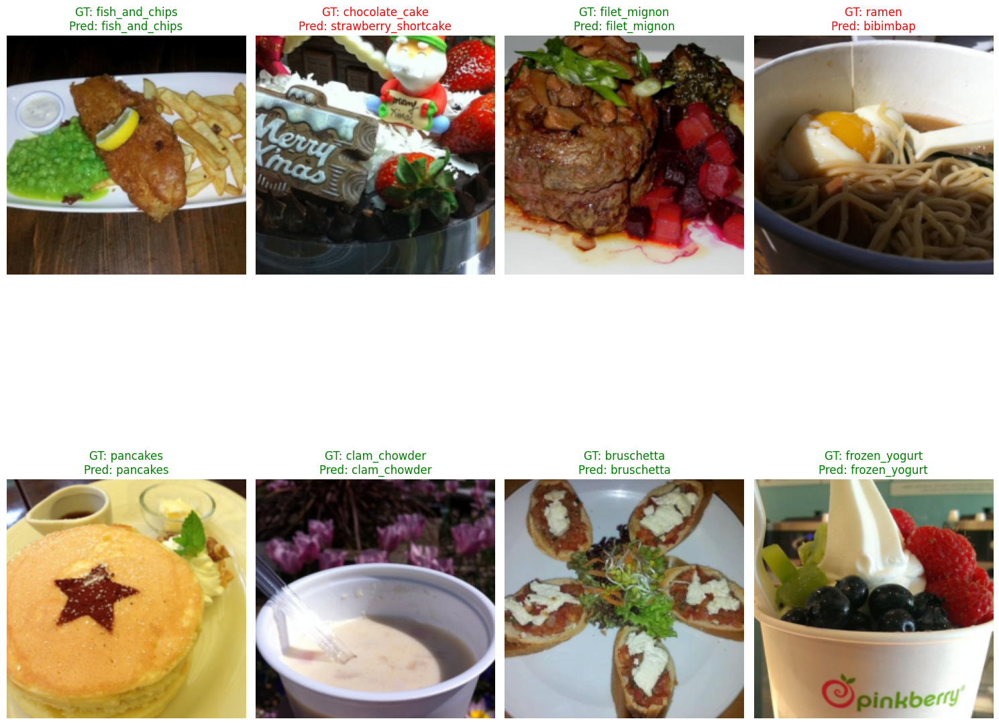

In [29]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # Undo normalization: img = img * std + mean
    # These are the values used in your transforms:
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])

    inp = inp.numpy().transpose((1, 2, 0)) # Convert from (C, H, W) to (H, W, C)
    inp = std * inp + mean # Denormalize
    inp = np.clip(inp, 0, 1) # Clip values to [0, 1] range for proper display
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off') # Turn off axes for cleaner image display

# Get a batch of test data
model.eval() # Set model to evaluation mode
dataiter = iter(test_loader)
images, labels = next(dataiter)

# Move images to the device for prediction
images = images.to(device)

# Make predictions
with torch.no_grad():
    outputs = model(images)
    _, predicted = torch.max(outputs, 1)

# Move tensors back to CPU for visualization
images = images.cpu()
labels = labels.cpu()
predicted = predicted.cpu()

# Plot the first N images from the batch
num_images_to_show = 8 # You can change this number
fig = plt.figure(figsize=(15, num_images_to_show * 2)) # Adjust figure size dynamically

for i in range(num_images_to_show):
    ax = fig.add_subplot(2, num_images_to_show // 2, i + 1, xticks=[], yticks=[])
    imshow(images[i])
    ground_truth_label = encoder.get_label(labels[i].item())
    predicted_label = encoder.get_label(predicted[i].item())

    # Set title color based on correctness
    color = "green" if ground_truth_label == predicted_label else "red"
    ax.set_title(f"GT: {ground_truth_label}\nPred: {predicted_label}", color=color)

plt.tight_layout()
plt.show()

In [30]:
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())


<div class="alert alert-info" style="font-size:16px; line-height:1.6;">
  <h4><strong>Confusion Matrix Overview</strong></h4>
  <p>
    The <strong>confusion matrix</strong> provides a detailed breakdown of the model’s performance by showing how predictions are distributed across all 101 food classes.
    It highlights:
    <ul>
      <li><strong>True Positives</strong> (correct classifications on the diagonal)</li>
      <li><strong>Misclassifications</strong> (off-diagonal elements)</li>
      <li>Common confusion between visually similar food items</li>
    </ul>
  </p>
</div>

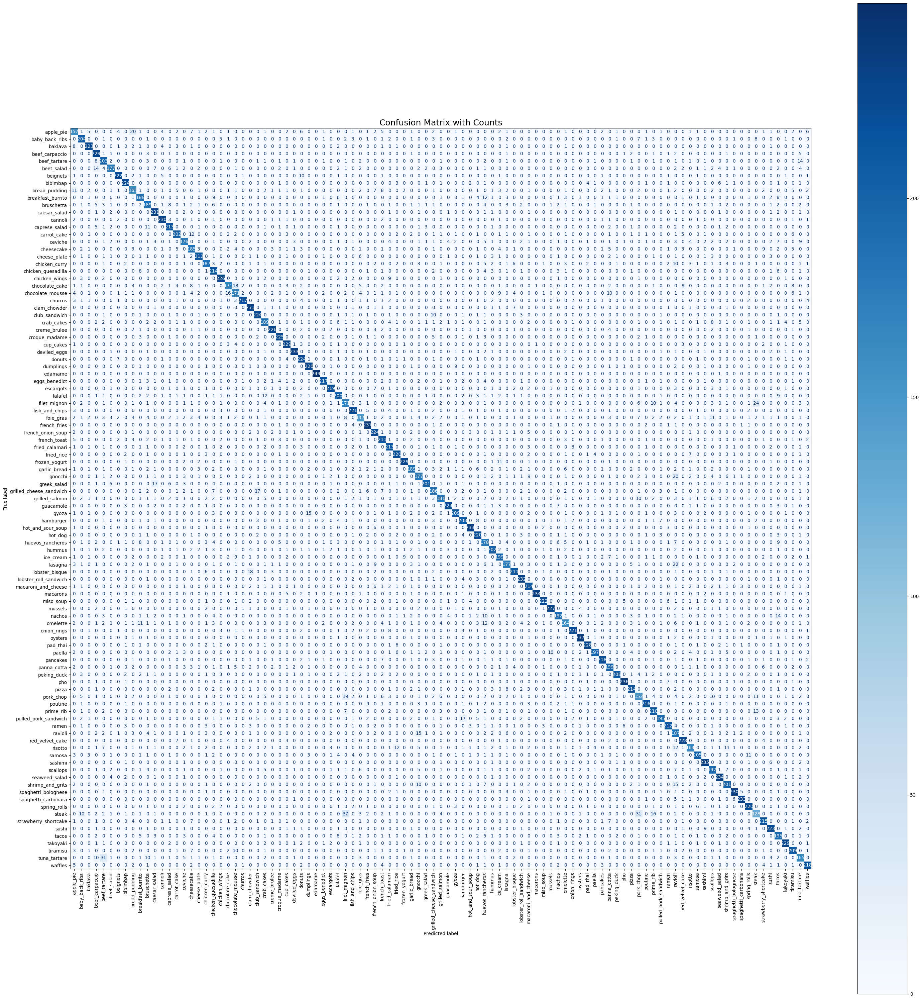

In [31]:
cm = confusion_matrix(all_labels, all_preds)
target_names = [encoder.get_label(i) for i in range(len(classes))]

# Plot with larger figure and values
fig, ax = plt.subplots(figsize=(30, 30))  # Adjust as needed
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)
disp.plot(include_values=True, xticks_rotation=90, ax=ax, cmap='Blues', colorbar=True)  # <- Show counts
plt.title("Confusion Matrix with Counts", fontsize=18)
plt.tight_layout()
plt.show()

#### Top confused classes

In [32]:
print("\n--- Top 20 Most Confused Pairs ---")
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

confusion_pairs = []
for i in range(len(target_names)):
    for j in range(len(target_names)):
        if i != j and cm_no_diag[i, j] > 0:
            confusion_pairs.append((cm_no_diag[i, j], target_names[i], target_names[j]))

confusion_pairs.sort(reverse=True)
for count, true_label, pred_label in confusion_pairs[:20]:
    print(f"{true_label:20} -> {pred_label:20} : {count:3d} times")


--- Top 20 Most Confused Pairs ---
steak                -> filet_mignon         :  37 times
tuna_tartare         -> beef_tartare         :  31 times
steak                -> pork_chop            :  31 times
filet_mignon         -> steak                :  24 times
lasagna              -> ravioli              :  22 times
gnocchi              -> ravioli              :  20 times
apple_pie            -> bread_pudding        :  20 times
pork_chop            -> filet_mignon         :  19 times
lobster_bisque       -> clam_chowder         :  18 times
chocolate_cake       -> chocolate_mousse     :  18 times
pulled_pork_sandwich -> hamburger            :  17 times
grilled_cheese_sandwich -> club_sandwich        :  17 times
greek_salad          -> caesar_salad         :  17 times
steak                -> prime_rib            :  16 times
chocolate_mousse     -> chocolate_cake       :  16 times
shrimp_and_grits     -> ravioli              :  15 times
ravioli              -> gnocchi              :  1

#### Classwise accuracy

In [33]:
# Per-class accuracy
print("\n--- Classes with Lowest Accuracy (Bottom 10) ---")
class_accuracy = []
for i in range(len(target_names)):
    total = cm[i].sum()
    if total > 0:
        accuracy = cm[i, i] / total
        class_accuracy.append((accuracy, target_names[i], total))

class_accuracy.sort()
for acc, class_name, total in class_accuracy[:10]:
    # Find the class index for this class name
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")

# Show classes with highest accuracy too
print("\n--- Classes with Highest Accuracy (Top 10) ---")
for acc, class_name, total in class_accuracy[-10:]:
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")


--- Classes with Lowest Accuracy (Bottom 10) ---
steak                : 0.512 (128/250 correct)
foie_gras            : 0.588 (147/250 correct)
pork_chop            : 0.608 (152/250 correct)
apple_pie            : 0.628 (157/250 correct)
omelette             : 0.656 (164/250 correct)
risotto              : 0.656 (164/250 correct)
bread_pudding        : 0.660 (165/250 correct)
tuna_tartare         : 0.660 (165/250 correct)
chocolate_cake       : 0.684 (171/250 correct)
chocolate_mousse     : 0.684 (171/250 correct)

--- Classes with Highest Accuracy (Top 10) ---
deviled_eggs         : 0.932 (233/250 correct)
hot_and_sour_soup    : 0.932 (233/250 correct)
spaghetti_carbonara  : 0.932 (233/250 correct)
macarons             : 0.936 (234/250 correct)
seaweed_salad        : 0.936 (234/250 correct)
sashimi              : 0.940 (235/250 correct)
pho                  : 0.944 (236/250 correct)
french_fries         : 0.948 (237/250 correct)
oysters              : 0.948 (237/250 correct)
edamame  

#### Summary Metrics

In [34]:
print("\n--- Summary Metrics ---")

overall_accuracy = accuracy_score(all_labels, all_preds)
macro_precision = precision_score(all_labels, all_preds, average='macro', zero_division=0)
macro_recall = recall_score(all_labels, all_preds, average='macro', zero_division=0)
macro_f1 = f1_score(all_labels, all_preds, average='macro', zero_division=0)

print(f"Overall Accuracy     : {overall_accuracy:.4f}")
print(f"Macro Precision      : {macro_precision:.4f}")
print(f"Macro Recall         : {macro_recall:.4f}")
print(f"Macro F1 Score       : {macro_f1:.4f}")



--- Summary Metrics ---
Overall Accuracy     : 0.8283
Macro Precision      : 0.8308
Macro Recall         : 0.8283
Macro F1 Score       : 0.8281


### Hybrid Model - RESNET50 + ViT

<div class="alert alert-success">

#### Hybrid Model: ResNet50 + ViT-B/16

#### Overview
Fusion of features from **ResNet50 (CNN)** and **ViT-B/16 (Transformer)** to leverage both **local** and **global** image representations.

---

#### **ResNet50 (CNN)**
- **Captures:** Local features such as edges, textures, and shapes through hierarchical convolutions.
- **Modification:** Final fully connected (`fc`) layer replaced with `nn.Identity()`, removing the original classifier.
- **Output Feature Vector:** `[Batch, 2048]` after global average pooling.
- **Trainable Layers:** Only **Layer 4** is trainable; all other layers are frozen.

---

#### **ViT-B/16 (Transformer-based)**
- **Captures:** Global context by splitting the image into **16×16 patches**, applying positional encoding, and self-attention.
- **Modification:** Classifier head (`heads`) replaced with `nn.Identity()` to retain only the **CLS token** features.
- **Output Feature Vector:** `[Batch, 768]` from the CLS token.
- **Training:** Entire ViT is used in **frozen mode** (no training).

---

#### **Feature Fusion**
- **ResNet Output:** 2048-dimensional vector.
- **ViT Output:** 768-dimensional vector.
- **Concatenation:** `2048 + 768 = 2816` → `[Batch, 2816]`.
- **Classifier Head:** Custom classifier maps the concatenated features to the target classes.
- **Training:** Only the classifier head is trained from scratch.
- **Output:** Logits vector representing class predictions.  
  - **Softmax** (applied during inference) → final class probabilities.

</div>


In [35]:
class HybridResNetViT(nn.Module):
    def __init__(self, num_classes):
        super(HybridResNetViT, self).__init__()

        # ResNet-50 (pretrained)
        self.resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
        for param in self.resnet.parameters():
            param.requires_grad = False
        for name, param in self.resnet.named_parameters():
            if 'layer4' in name or 'fc' in name:
                param.requires_grad = True
        self.resnet.fc = nn.Identity()  # Remove final layer

        # Vision Transformer (pretrained)
        self.vit = models.vit_b_16(weights=models.ViT_B_16_Weights.IMAGENET1K_V1)
        for param in self.vit.parameters():
            param.requires_grad = False
        self.vit.heads = nn.Identity()  # Remove ViT head

        # Combined classifier
        self.classifier = nn.Sequential(
            nn.Linear(2048 + 768, 512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes)
        )

    def forward(self, x):
        x_resnet = self.resnet(x)  # Output shape: [B, 2048]
        x_vit = self.vit(x)        # Output shape: [B, 768]
        x_combined = torch.cat((x_resnet, x_vit), dim=1)  # Shape: [B, 2816]
        return self.classifier(x_combined)

In [36]:
num_classes = len(classes)  # classes = encoder.label2idx.keys() or similar
model = HybridResNetViT(num_classes).to(device)

# Print model summary
from torchinfo import summary
summary(model, input_size=(1, 3, 224, 224), device=device)

Layer (type:depth-idx)                             Output Shape              Param #
HybridResNetViT                                    [1, 101]                  --
├─ResNet: 1-1                                      [1, 2048]                 --
│    └─Conv2d: 2-1                                 [1, 64, 112, 112]         (9,408)
│    └─BatchNorm2d: 2-2                            [1, 64, 112, 112]         (128)
│    └─ReLU: 2-3                                   [1, 64, 112, 112]         --
│    └─MaxPool2d: 2-4                              [1, 64, 56, 56]           --
│    └─Sequential: 2-5                             [1, 256, 56, 56]          --
│    │    └─Bottleneck: 3-1                        [1, 256, 56, 56]          (75,008)
│    │    └─Bottleneck: 3-2                        [1, 256, 56, 56]          (70,400)
│    │    └─Bottleneck: 3-3                        [1, 256, 56, 56]          (70,400)
│    └─Sequential: 2-6                             [1, 512, 28, 28]          --
│    │   

#### Optimizer and Loss Function

<div class="alert alert-success">

Optimizer and Loss Function

- **Optimizer**: `AdamW`  
  - Recommended for fine-tuning transformer-based models  
  - Initial Learning Rate: **5e-4**  
  - Weight Decay: **1e-2** (for regularization)

- **Loss Function**: `CrossEntropyLoss`  
  - Suitable for **multi-class classification** problems like Food-101  
  - Encourages the model to assign high probability to the correct class

- **Epochs**: `10`  
  - Selected to balance between learning and **preventing overfitting**

- **Batch Size**: `32`  
  - A common setting that offers a good trade-off between **computational efficiency**

</div>


In [37]:
# Filter parameters that require gradients
trainable_params = filter(lambda p: p.requires_grad, model.parameters())

# AdamW is recommended for finetuning
optimizer = optim.AdamW(
    trainable_params,
    lr=5e-4,           # learning rate (adjust as needed)
    weight_decay=1e-2  # weight decay (regularization)
)
loss_fn = nn.CrossEntropyLoss()

#### Early Stopping

In [38]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.best_model_state = None

    def __call__(self, val_loss, model):
        if self.best_loss is None or val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.best_model_state = model.state_dict()
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

#### Training the Model

In [39]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs,patience = 3):
    model.to(device) # Ensure model is on the correct device
    early_stopper = EarlyStopping(patience=patience)
    
    print("\nStarting training...")
    for epoch in range(num_epochs):
        model.train() # Set model to training mode
        running_loss = 0.0
        correct_preds = 0
        total_samples = 0

        train_loop = tqdm(train_loader, leave=True, desc=f"Epoch {epoch+1}/{num_epochs} Train")

        for images, labels in train_loop:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad() # Zero the gradients
            outputs = model(images) # Forward pass
            loss = loss_fn(outputs, labels) # Calculate loss
            loss.backward() # Backward pass
            optimizer.step() # Update weights

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1) # Get predictions
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            train_loop.set_postfix(loss=loss.item())


        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Accuracy: {epoch_acc:.4f}")

        # Evaluate on validation set after each epoch
        test_model(model, val_loader, loss_fn, device)

        # Early stopping
        early_stopper(val_loss, model)
        if early_stopper.early_stop:
            print("Early stopping triggered. Stopping training.")
            break

    # Restore best model weights before returning
    model.load_state_dict(early_stopper.best_model_state)
    print("Training complete. Best model loaded.")
    return model

#### Testing the Model

In [42]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs, patience=3):
    model.to(device)
    early_stopper = EarlyStopping(patience=patience)

    print("\nStarting training...")
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        running_loss, correct_preds, total_samples = 0.0, 0, 0

        for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} Train"):
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Accuracy: {epoch_acc:.4f}")

        # Validation phase
        model.eval()
        val_running_loss, val_correct_preds, val_total_samples = 0.0, 0, 0
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, labels)
                val_running_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct_preds += (predicted == labels).sum().item()
                val_total_samples += labels.size(0)

        val_loss = val_running_loss / val_total_samples
        val_acc = val_correct_preds / val_total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Val Loss: {val_loss:.4f} | Val Accuracy: {val_acc:.4f}")

        # Early stopping
        early_stopper(val_loss, model)
        if early_stopper.early_stop:
            print("Early stopping triggered. Stopping training.")
            break

    # Restore best model weights before returning
    model.load_state_dict(early_stopper.best_model_state)
    print("Training complete. Best model loaded.")
    return model

In [43]:
# The Hybrid Model is computationally expensive so sticking out to 10 epochs 
num_epochs = 10 # You can adjust this value 
trained_model = train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs=num_epochs)



Starting training...


Epoch 1/10 Train: 100%|█████████████████████| 2131/2131 [39:11<00:00,  1.10s/it]


[Epoch 1/10] Train Loss: 1.5538 | Accuracy: 0.5978
[Epoch 1/10] Val Loss: 1.0987 | Val Accuracy: 0.7114


Epoch 2/10 Train: 100%|█████████████████████| 2131/2131 [38:32<00:00,  1.09s/it]


[Epoch 2/10] Train Loss: 1.4078 | Accuracy: 0.6341
[Epoch 2/10] Val Loss: 1.0435 | Val Accuracy: 0.7196


Epoch 3/10 Train: 100%|█████████████████████| 2131/2131 [37:29<00:00,  1.06s/it]


[Epoch 3/10] Train Loss: 1.2877 | Accuracy: 0.6605
[Epoch 3/10] Val Loss: 0.9771 | Val Accuracy: 0.7402


Epoch 4/10 Train: 100%|█████████████████████| 2131/2131 [37:28<00:00,  1.05s/it]


[Epoch 4/10] Train Loss: 1.2352 | Accuracy: 0.6752
[Epoch 4/10] Val Loss: 0.9664 | Val Accuracy: 0.7446


Epoch 5/10 Train: 100%|█████████████████████| 2131/2131 [37:13<00:00,  1.05s/it]


[Epoch 5/10] Train Loss: 1.1769 | Accuracy: 0.6903
[Epoch 5/10] Val Loss: 0.9589 | Val Accuracy: 0.7469


Epoch 6/10 Train: 100%|█████████████████████| 2131/2131 [41:56<00:00,  1.18s/it]


[Epoch 6/10] Train Loss: 1.1201 | Accuracy: 0.7026
[Epoch 6/10] Val Loss: 0.9401 | Val Accuracy: 0.7516


Epoch 7/10 Train: 100%|█████████████████████| 2131/2131 [41:41<00:00,  1.17s/it]


[Epoch 7/10] Train Loss: 1.0721 | Accuracy: 0.7148
[Epoch 7/10] Val Loss: 0.9146 | Val Accuracy: 0.7604


Epoch 8/10 Train: 100%|█████████████████████| 2131/2131 [38:07<00:00,  1.07s/it]


[Epoch 8/10] Train Loss: 1.0435 | Accuracy: 0.7212
[Epoch 8/10] Val Loss: 0.9069 | Val Accuracy: 0.7691


Epoch 9/10 Train: 100%|█████████████████████| 2131/2131 [38:15<00:00,  1.08s/it]


[Epoch 9/10] Train Loss: 1.0255 | Accuracy: 0.7256
[Epoch 9/10] Val Loss: 0.9156 | Val Accuracy: 0.7678


Epoch 10/10 Train: 100%|████████████████████| 2131/2131 [38:09<00:00,  1.07s/it]


[Epoch 10/10] Train Loss: 0.9833 | Accuracy: 0.7365
[Epoch 10/10] Val Loss: 0.8995 | Val Accuracy: 0.7712
Training complete. Best model loaded.


In [46]:
test_model(trained_model, test_loader, loss_fn, device)
print("\nTesting complete!")

Testing: 100%|████████████████████| 790/790 [12:18<00:00,  1.07it/s, loss=0.552]

Test Loss: 0.6497 | Overall Accuracy: 0.8206

--- Per-Class Metrics ---
                         precision    recall  f1-score   support

              apple_pie       0.73      0.48      0.57       250
         baby_back_ribs       0.78      0.84      0.81       250
                baklava       0.88      0.89      0.89       250
         beef_carpaccio       0.81      0.90      0.85       250
           beef_tartare       0.79      0.82      0.81       250
             beet_salad       0.74      0.76      0.75       250
               beignets       0.88      0.90      0.89       250
               bibimbap       0.87      0.94      0.91       250
          bread_pudding       0.54      0.72      0.62       250
      breakfast_burrito       0.68      0.75      0.71       250
             bruschetta       0.80      0.71      0.75       250
           caesar_salad       0.87      0.89      0.88       250
                cannoli       0.92      0.88      0.90       250
          caprese

#### Results

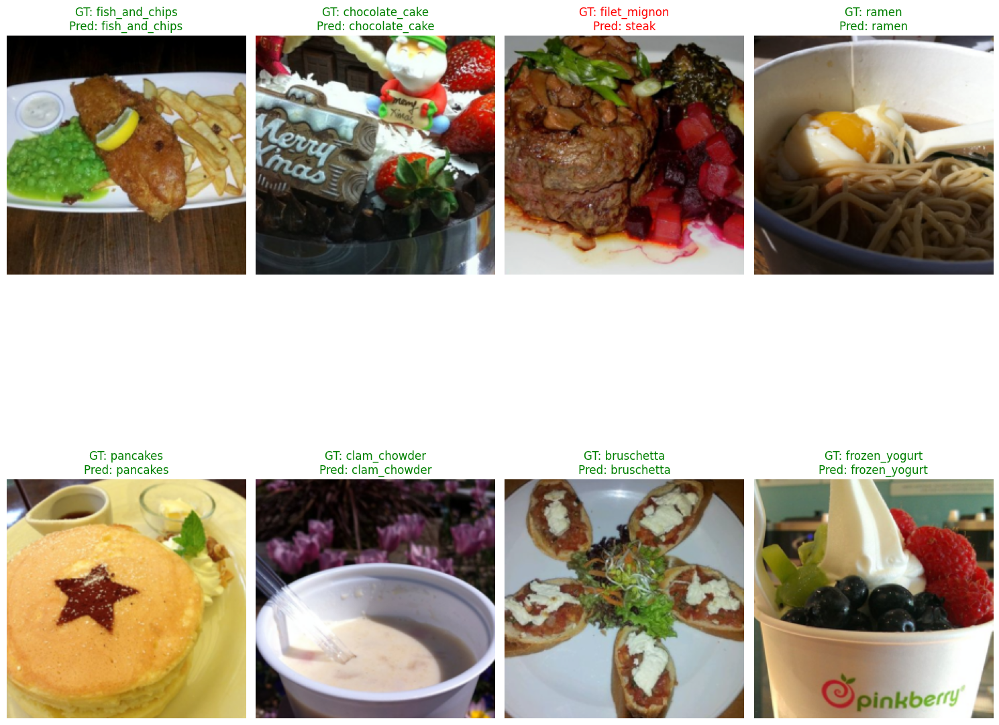

In [49]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # Undo normalization: img = img * std + mean
    # These are the values used in your transforms:
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225]) 

    inp = inp.numpy().transpose((1, 2, 0)) # Convert from (C, H, W) to (H, W, C)
    inp = std * inp + mean # Denormalize
    inp = np.clip(inp, 0, 1) # Clip values to [0, 1] range for proper display
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off') # Turn off axes for cleaner image display

# Get a batch of test data
model.eval() # Set model to evaluation mode
dataiter = iter(test_loader)
images, labels = next(dataiter)

# Move images to the device for prediction
images = images.to(device)

# Make predictions
with torch.no_grad():
    outputs = model(images)
    _, predicted = torch.max(outputs, 1)

# Move tensors back to CPU for visualization
images = images.cpu()
labels = labels.cpu()
predicted = predicted.cpu()

# Plot the first N images from the batch
num_images_to_show = 8 # You can change this number
fig = plt.figure(figsize=(15, num_images_to_show * 2)) # Adjust figure size dynamically

for i in range(num_images_to_show):
    ax = fig.add_subplot(2, num_images_to_show // 2, i + 1, xticks=[], yticks=[])
    imshow(images[i])
    ground_truth_label = encoder.get_label(labels[i].item())
    predicted_label = encoder.get_label(predicted[i].item())

    # Set title color based on correctness
    color = "green" if ground_truth_label == predicted_label else "red"
    ax.set_title(f"GT: {ground_truth_label}\nPred: {predicted_label}", color=color)

plt.tight_layout()
plt.show()

In [45]:
torch.save(trained_model, "resnet50_vit_food101_hybrid.pth")

In [51]:
# Load the model
add_safe_globals([resnet50])
model = torch.load("resnet50_vit_food101_hybrid.pth", weights_only=False)
model.to(device)
model.eval()


HybridResNetViT(
  (resnet): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
   

In [52]:
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())


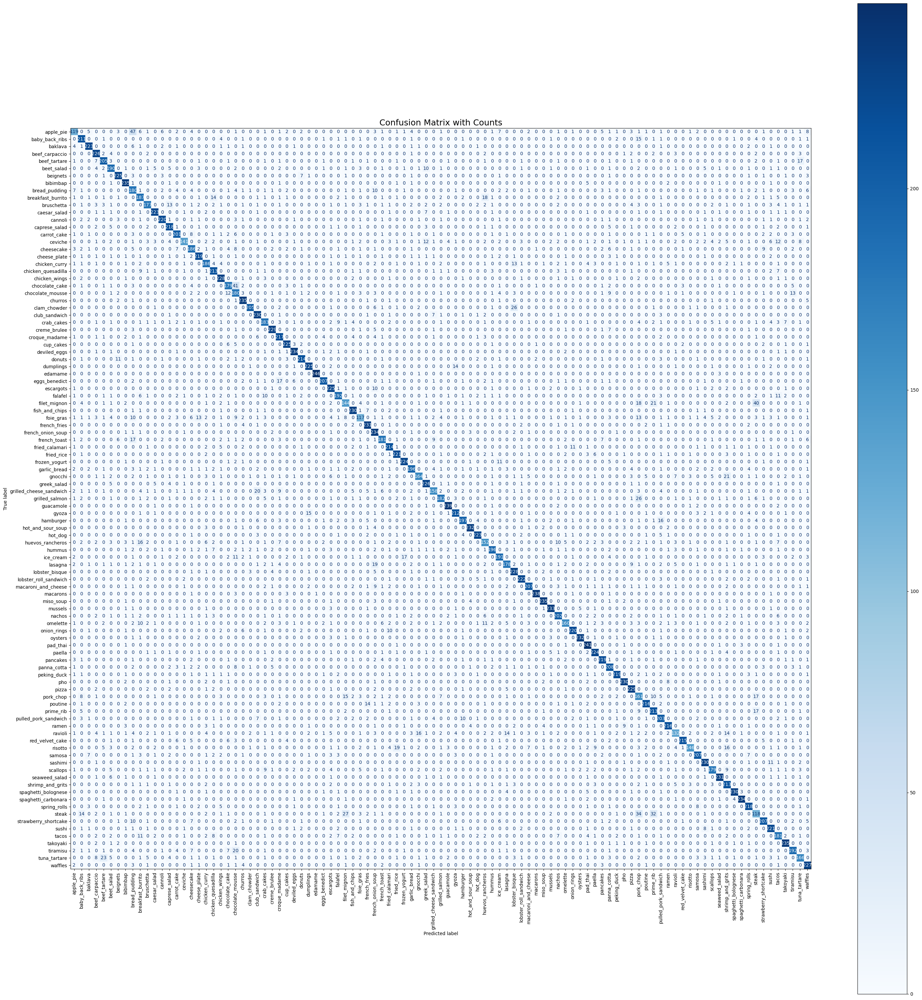

In [53]:
# Generate confusion matrix
cm = confusion_matrix(all_labels, all_preds)

# Get class names
target_names = [encoder.get_label(i) for i in range(len(classes))]

# Plot with larger figure and values
fig, ax = plt.subplots(figsize=(30, 30))  # Adjust as needed
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)
disp.plot(include_values=True, xticks_rotation=90, ax=ax, cmap='Blues', colorbar=True)  # <- Show counts
plt.title("Confusion Matrix with Counts", fontsize=18)
plt.tight_layout()
plt.show()


In [54]:
print("\n--- Top 20 Most Confused Pairs ---")
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

confusion_pairs = []
for i in range(len(target_names)):
    for j in range(len(target_names)):
        if i != j and cm_no_diag[i, j] > 0:
            confusion_pairs.append((cm_no_diag[i, j], target_names[i], target_names[j]))

confusion_pairs.sort(reverse=True)
for count, true_label, pred_label in confusion_pairs[:20]:
    print(f"{true_label:20} -> {pred_label:20} : {count:3d} times")


--- Top 20 Most Confused Pairs ---
apple_pie            -> bread_pudding        :  47 times
chocolate_cake       -> chocolate_mousse     :  41 times
filet_mignon         -> steak                :  40 times
steak                -> pork_chop            :  34 times
steak                -> prime_rib            :  32 times
steak                -> filet_mignon         :  27 times
grilled_salmon       -> pork_chop            :  26 times
clam_chowder         -> lobster_bisque       :  26 times
tuna_tartare         -> beef_tartare         :  23 times
gnocchi              -> shrimp_and_grits     :  21 times
filet_mignon         -> prime_rib            :  21 times
tiramisu             -> chocolate_mousse     :  20 times
grilled_cheese_sandwich -> club_sandwich        :  20 times
risotto              -> fried_rice           :  19 times
lasagna              -> french_onion_soup    :  19 times
filet_mignon         -> pork_chop            :  18 times
breakfast_burrito    -> huevos_rancheros     :  1

In [55]:
# Per-class accuracy
print("\n--- Classes with Lowest Accuracy (Bottom 10) ---")
class_accuracy = []
for i in range(len(target_names)):
    total = cm[i].sum()
    if total > 0:
        accuracy = cm[i, i] / total
        class_accuracy.append((accuracy, target_names[i], total))

class_accuracy.sort()
for acc, class_name, total in class_accuracy[:10]:
    # Find the class index for this class name
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")

# Show classes with highest accuracy too
print("\n--- Classes with Highest Accuracy (Top 10) ---")
for acc, class_name, total in class_accuracy[-10:]:
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")


--- Classes with Lowest Accuracy (Bottom 10) ---
foie_gras            : 0.468 (117/250 correct)
steak                : 0.472 (118/250 correct)
apple_pie            : 0.476 (119/250 correct)
ravioli              : 0.528 (132/250 correct)
ceviche              : 0.564 (141/250 correct)
filet_mignon         : 0.576 (144/250 correct)
risotto              : 0.584 (146/250 correct)
huevos_rancheros     : 0.608 (152/250 correct)
grilled_cheese_sandwich : 0.632 (158/250 correct)
omelette             : 0.640 (160/250 correct)

--- Classes with Highest Accuracy (Top 10) ---
french_onion_soup    : 0.936 (234/250 correct)
spaghetti_carbonara  : 0.936 (234/250 correct)
bibimbap             : 0.940 (235/250 correct)
churros              : 0.940 (235/250 correct)
miso_soup            : 0.940 (235/250 correct)
takoyaki             : 0.940 (235/250 correct)
macarons             : 0.952 (238/250 correct)
guacamole            : 0.956 (239/250 correct)
pad_thai             : 0.964 (241/250 correct)
edamam

In [56]:
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score, accuracy_score

# --- Summary Metrics ---
print("\n--- Summary Metrics ---")

overall_accuracy = accuracy_score(all_labels, all_preds)
macro_precision = precision_score(all_labels, all_preds, average='macro', zero_division=0)
macro_recall = recall_score(all_labels, all_preds, average='macro', zero_division=0)
macro_f1 = f1_score(all_labels, all_preds, average='macro', zero_division=0)


print(f"Overall Accuracy     : {overall_accuracy:.4f}")
print(f"Macro Precision      : {macro_precision:.4f}")
print(f"Macro Recall         : {macro_recall:.4f}")
print(f"Macro F1 Score       : {macro_f1:.4f}")



--- Summary Metrics ---
Overall Accuracy     : 0.8206
Macro Precision      : 0.8239
Macro Recall         : 0.8206
Macro F1 Score       : 0.8189


### Efficientnet

<div class="alert alert-success">
    <h4><strong>EfficientNet-B4</strong></h4>
  <p>
    EfficientNet-B4 is a CNN architecture that scales network depth, width, and resolution in a balanced way using a compound scaling method. It employs depthwise separable convolutions and squeeze-and-excitation blocks to achieve high accuracy while keeping the parameter count relatively low.
  </p>
  <h4><strong>Why Use EfficientNet-B4?</strong></h4>

  <h5>Performance–Efficiency Balance</h5>
  <p>
    Achieves strong classification accuracy while keeping parameter count and computation low, making it ideal for large-scale datasets.
  </p>

  <h5>Feature Extraction</h5>
  <p>
    Learns both fine-grained and high-level image features effectively, crucial for differentiating similar food categories.
  </p>

  <h5>Transfer Learning Benefits</h5>
  <p>
    Utilizes pretrained weights from ImageNet to accelerate convergence and improve generalization.
    <ul>
      <li>Reduced training time</li>
      <li>Lower overfitting risk</li>
      <li>Better initial performance</li>
    </ul>
  </p>

  <p>
    For these reasons, EfficientNet-B4 was selected for the Food-101 dataset.
  </p>
</div>



<div class="alert alert-success">
<h4><strong>Why These Transforms Work Best for EfficientNet-B4</strong></h4>
 
  <h5>Alignment with Pretrained Model Expectations</h5>
<p>
    EfficientNet-B4 was <strong>pretrained on ImageNet</strong> with an input size of <strong>380x380</strong> pixels
    and specific normalization parameters (<code>mean=[0.485, 0.456, 0.406]</code>, <code>std=[0.229, 0.224, 0.225]</code>).
    By using <code>RandomResizedCrop(380)</code> for training and <code>CenterCrop(380)</code> for testing,
    your pipeline ensures the model receives <strong>input dimensions and pixel distributions it was optimized for</strong>,
    which maximizes transfer learning performance.
</p>
 
  <h5>Balanced Augmentation for Robustness</h5>
<p>
    The combination of <code>RandomHorizontalFlip(p=0.5)</code> and carefully chosen crop/resize operations
    introduces <strong>natural variation</strong> in the dataset without distorting object geometry.
    For evaluation, <code>Resize(438) → CenterCrop(380)</code> mirrors the <strong>standard ImageNet evaluation pipeline</strong>,
    preserving aspect ratios and avoiding stretch artifacts, leading to <strong>consistent and unbiased results</strong>.
</p>
</div>

#### Image Transforms

<div class="alert alert-success">
<h4><strong>Why These Transforms Work Best for EfficientNet-B4</strong></h4>
 
  <h5>Alignment with Pretrained Model Expectations</h5>
<p>
    EfficientNet-B4 was <strong>pretrained on ImageNet</strong> with an input size of <strong>380x380</strong> pixels
    and specific normalization parameters (<code>mean=[0.485, 0.456, 0.406]</code>, <code>std=[0.229, 0.224, 0.225]</code>).
    By using <code>RandomResizedCrop(380)</code> for training and <code>CenterCrop(380)</code> for testing,
    your pipeline ensures the model receives <strong>input dimensions and pixel distributions it was optimized for</strong>,
    which maximizes transfer learning performance.
</p>
 
  <h5>Balanced Augmentation for Robustness</h5>
<p>
    The combination of <code>RandomHorizontalFlip(p=0.5)</code> and carefully chosen crop/resize operations
    introduces <strong>natural variation</strong> in the dataset without distorting object geometry.
    For evaluation, <code>Resize(438) → CenterCrop(380)</code> mirrors the <strong>standard ImageNet evaluation pipeline</strong>,
    preserving aspect ratios and avoiding stretch artifacts, leading to <strong>consistent and unbiased results</strong>.
</p>
</div>

In [24]:
# Training transforms
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop(380),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transforms = transforms.Compose([
    transforms.Resize(438),  # Resize to slightly larger
    transforms.CenterCrop(380),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [30]:
# Import EfficientNet
from torchvision.models import efficientnet_b4, EfficientNet_B4_Weights

# Load pretrained EfficientNet-B4
weights = EfficientNet_B4_Weights.IMAGENET1K_V1
model = efficientnet_b4(weights=weights)

# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

# Unfreeze the last few blocks and classifier
# EfficientNet has blocks from features[0] to features[8]
# We'll unfreeze the last 2 blocks (features[7] and features[8]) and the classifier
for name, param in model.named_parameters():
    if 'features.7' in name or 'features.8' in name or 'classifier' in name:
        param.requires_grad = True

# Replace final classification head
num_classes = len(classes)
# EfficientNet uses 'classifier' instead of 'fc'
in_features = model.classifier[1].in_features
model.classifier = nn.Sequential(
    nn.Dropout(p=0.4, inplace=True),
    nn.Linear(in_features, num_classes)
)

# Move model to device (MPS)
model = model.to(device)

In [32]:
from torchinfo import summary
summary(model, input_size=(1, 3, 380, 380), device=device)


Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [1, 101]                  --
├─Sequential: 1-1                                       [1, 1792, 12, 12]         --
│    └─Conv2dNormActivation: 2-1                        [1, 48, 190, 190]         --
│    │    └─Conv2d: 3-1                                 [1, 48, 190, 190]         (1,296)
│    │    └─BatchNorm2d: 3-2                            [1, 48, 190, 190]         (96)
│    │    └─SiLU: 3-3                                   [1, 48, 190, 190]         --
│    └─Sequential: 2-2                                  [1, 24, 190, 190]         --
│    │    └─MBConv: 3-4                                 [1, 24, 190, 190]         (2,940)
│    │    └─MBConv: 3-5                                 [1, 24, 190, 190]         (1,206)
│    └─Sequential: 2-3                                  [1, 32, 95, 95]           --
│    │    └─MBConv: 3-6                    

#### Optimizer and Loss Function ####

<div class="alert alert-success">

**Optimizer and Loss Function**

- **Optimizer**:   
  - AdamW — chosen for stable fine-tuning and effective weight decay regularization.  
  - Initial Learning Rate: 5 × 10⁻⁴  
  - Weight Decay: 0.05 (higher to improve generalization)

- **Loss Function**:  
  - CrossEntropyLoss with label smoothing (0.1) to reduce overconfidence in predictions.  
  - Helps improve calibration and robustness.

- **Epochs**: 20  
  - Selected to allow sufficient fine-tuning while minimizing overfitting risk.

- **Batch Size**: 32  

</div>


In [32]:
# Filter parameters that require gradients
trainable_params = filter(lambda p: p.requires_grad, model.parameters())

# Define optimizer: AdamW is recommended for finetuning
optimizer = optim.AdamW(
    filter(lambda p: p.requires_grad, model.parameters()),
    lr=5e-4,
    weight_decay=5e-2,  # Higher weight decay
    betas=(0.9, 0.999)
)

# Replace loss function
loss_fn = nn.CrossEntropyLoss(label_smoothing=0.1)

#### Early Stoppage

In [34]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.best_model_state = None

    def __call__(self, val_loss, model):
        if self.best_loss is None or val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.best_model_state = model.state_dict()
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

#### Training Function ####

In [37]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs, early_stopping=None):
    model.to(device)
    best_val_loss = float('inf')

    print("\nStarting training...")
    for epoch in range(num_epochs):
        # Training Phase
        model.train()
        running_loss = 0.0
        correct_preds = 0
        total_samples = 0

        train_loop = tqdm(train_loader, leave=True, desc=f"Epoch {epoch+1}/{num_epochs} Train")

        for images, labels in train_loop:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            train_loop.set_postfix(loss=loss.item())

        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Train Accuracy: {epoch_acc:.4f}")

        # Validation Phase
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, labels)
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

        avg_val_loss = val_loss / val_total
        val_accuracy = val_correct / val_total
        print(f"[Epoch {epoch+1}/{num_epochs}] Val Loss: {avg_val_loss:.4f} | Val Accuracy: {val_accuracy:.4f}")

        # Early Stopping
        if early_stopping:
            early_stopping(avg_val_loss, model)
            if early_stopping.early_stop:
                print("Early stopping triggered.")
                break

    # Loading best model weights after training
    if early_stopping and early_stopping.best_model_state:
        model.load_state_dict(early_stopping.best_model_state)
        print("Loaded best model weights from early stopping.")


#### Testing/Evaluation Function (with Per-Class Metrics) ####

In [39]:
def test_model(model, val_loader, loss_fn, device):
    model.eval() # Set model to evaluation mode
    total_loss = 0.0
    correct_preds = 0
    total_samples = 0

    all_predictions = []
    all_true_labels = []

    val_loop = tqdm(val_loader, leave=True, desc="Validation")

    with torch.no_grad(): # Disable gradient calculations during evaluation
        for images, labels in val_loop:
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = loss_fn(outputs, labels)

            total_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            # Collect predictions and true labels for per-class metrics
            all_predictions.extend(predicted.cpu().numpy())
            all_true_labels.extend(labels.cpu().numpy())

            val_loop.set_postfix(loss=loss.item())

    avg_loss = total_loss / total_samples
    accuracy = correct_preds / total_samples
    print(f"Validation Loss: {avg_loss:.4f} | Overall Accuracy: {accuracy:.4f}")

    # --- Calculate and print per-class metrics ---
    print("\n--- Per-Class Metrics ---")
    target_names = [encoder.get_label(i) for i in range(len(classes))]

    # 'zero_division=0' handles cases where a class might have no true instances or no predicted instances
    report = classification_report(all_true_labels, all_predictions, target_names=target_names, zero_division=0)
    print(report)

In [40]:
num_epochs = 20 # You can adjust this value
trained_model = train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs=num_epochs)

print("\nTraining complete!")


Starting training...


Epoch 1/20 Train: 100%|██████████| 2131/2131 [15:48<00:00,  2.25it/s, loss=2.68]


[Epoch 1/20] Train Loss: 2.7393 | Train Accuracy: 0.4582
[Epoch 1/20] Val Loss: 1.9004 | Val Accuracy: 0.6848


Epoch 2/20 Train: 100%|██████████| 2131/2131 [16:21<00:00,  2.17it/s, loss=1.67]


[Epoch 2/20] Train Loss: 2.2361 | Train Accuracy: 0.5908
[Epoch 2/20] Val Loss: 1.7559 | Val Accuracy: 0.7267


Epoch 3/20 Train: 100%|██████████| 2131/2131 [16:35<00:00,  2.14it/s, loss=2.23]


[Epoch 3/20] Train Loss: 2.0972 | Train Accuracy: 0.6282
[Epoch 3/20] Val Loss: 1.6909 | Val Accuracy: 0.7444


Epoch 4/20 Train: 100%|██████████| 2131/2131 [16:31<00:00,  2.15it/s, loss=2.57]


[Epoch 4/20] Train Loss: 2.0193 | Train Accuracy: 0.6494
[Epoch 4/20] Val Loss: 1.6380 | Val Accuracy: 0.7637


Epoch 5/20 Train: 100%|██████████| 2131/2131 [17:27<00:00,  2.04it/s, loss=2.42]


[Epoch 5/20] Train Loss: 1.9512 | Train Accuracy: 0.6689
[Epoch 5/20] Val Loss: 1.6120 | Val Accuracy: 0.7694


Epoch 6/20 Train: 100%|██████████| 2131/2131 [15:36<00:00,  2.27it/s, loss=2.09]


[Epoch 6/20] Train Loss: 1.9059 | Train Accuracy: 0.6822
[Epoch 6/20] Val Loss: 1.5852 | Val Accuracy: 0.7724


Epoch 7/20 Train: 100%|██████████| 2131/2131 [15:05<00:00,  2.35it/s, loss=2.34]


[Epoch 7/20] Train Loss: 1.8664 | Train Accuracy: 0.6932
[Epoch 7/20] Val Loss: 1.5709 | Val Accuracy: 0.7842


Epoch 8/20 Train: 100%|██████████| 2131/2131 [15:09<00:00,  2.34it/s, loss=1.95]


[Epoch 8/20] Train Loss: 1.8418 | Train Accuracy: 0.7014
[Epoch 8/20] Val Loss: 1.5597 | Val Accuracy: 0.7794


Epoch 9/20 Train: 100%|██████████| 2131/2131 [15:09<00:00,  2.34it/s, loss=2.27]


[Epoch 9/20] Train Loss: 1.8143 | Train Accuracy: 0.7086
[Epoch 9/20] Val Loss: 1.5567 | Val Accuracy: 0.7810


Epoch 10/20 Train: 100%|██████████| 2131/2131 [15:10<00:00,  2.34it/s, loss=1.78]


[Epoch 10/20] Train Loss: 1.7992 | Train Accuracy: 0.7127
[Epoch 10/20] Val Loss: 1.5422 | Val Accuracy: 0.7828


Epoch 11/20 Train: 100%|██████████| 2131/2131 [15:07<00:00,  2.35it/s, loss=1.94]


[Epoch 11/20] Train Loss: 1.7719 | Train Accuracy: 0.7196
[Epoch 11/20] Val Loss: 1.5368 | Val Accuracy: 0.7822


Epoch 12/20 Train: 100%|██████████| 2131/2131 [15:09<00:00,  2.34it/s, loss=2.18]


[Epoch 12/20] Train Loss: 1.7561 | Train Accuracy: 0.7244
[Epoch 12/20] Val Loss: 1.5370 | Val Accuracy: 0.7838


Epoch 13/20 Train: 100%|██████████| 2131/2131 [15:11<00:00,  2.34it/s, loss=2.07]


[Epoch 13/20] Train Loss: 1.7445 | Train Accuracy: 0.7275
[Epoch 13/20] Val Loss: 1.5317 | Val Accuracy: 0.7838


Epoch 14/20 Train: 100%|██████████| 2131/2131 [15:09<00:00,  2.34it/s, loss=1.33]


[Epoch 14/20] Train Loss: 1.7352 | Train Accuracy: 0.7311
[Epoch 14/20] Val Loss: 1.5277 | Val Accuracy: 0.7843


Epoch 15/20 Train: 100%|██████████| 2131/2131 [15:10<00:00,  2.34it/s, loss=1.78]


[Epoch 15/20] Train Loss: 1.7241 | Train Accuracy: 0.7346
[Epoch 15/20] Val Loss: 1.5263 | Val Accuracy: 0.7856


Epoch 16/20 Train: 100%|██████████| 2131/2131 [15:10<00:00,  2.34it/s, loss=1.4] 


[Epoch 16/20] Train Loss: 1.7134 | Train Accuracy: 0.7367
[Epoch 16/20] Val Loss: 1.5297 | Val Accuracy: 0.7901


Epoch 17/20 Train: 100%|██████████| 2131/2131 [15:02<00:00,  2.36it/s, loss=1.53]


[Epoch 17/20] Train Loss: 1.7073 | Train Accuracy: 0.7382
[Epoch 17/20] Val Loss: 1.5136 | Val Accuracy: 0.7918


Epoch 18/20 Train: 100%|██████████| 2131/2131 [15:11<00:00,  2.34it/s, loss=2.27]


[Epoch 18/20] Train Loss: 1.7016 | Train Accuracy: 0.7413
[Epoch 18/20] Val Loss: 1.5186 | Val Accuracy: 0.7880


Epoch 19/20 Train: 100%|██████████| 2131/2131 [15:09<00:00,  2.34it/s, loss=1.94]


[Epoch 19/20] Train Loss: 1.7014 | Train Accuracy: 0.7411
[Epoch 19/20] Val Loss: 1.5280 | Val Accuracy: 0.7876


Epoch 20/20 Train: 100%|██████████| 2131/2131 [15:10<00:00,  2.34it/s, loss=1.52]


[Epoch 20/20] Train Loss: 1.6969 | Train Accuracy: 0.7423
[Epoch 20/20] Val Loss: 1.5295 | Val Accuracy: 0.7873

Training complete!


In [120]:
test_model(model, test_loader, loss_fn, device)
print("\nTraining complete!")

Validation: 100%|██████████| 790/790 [05:38<00:00,  2.33it/s, loss=0.924]

Validation Loss: 1.3690 | Overall Accuracy: 0.8312

--- Per-Class Metrics ---
                         precision    recall  f1-score   support

              apple_pie       0.69      0.59      0.64       250
         baby_back_ribs       0.73      0.86      0.79       250
                baklava       0.87      0.90      0.89       250
         beef_carpaccio       0.86      0.92      0.89       250
           beef_tartare       0.72      0.87      0.78       250
             beet_salad       0.76      0.74      0.75       250
               beignets       0.93      0.82      0.87       250
               bibimbap       0.93      0.90      0.91       250
          bread_pudding       0.67      0.62      0.64       250
      breakfast_burrito       0.80      0.78      0.79       250
             bruschetta       0.85      0.73      0.79       250
           caesar_salad       0.85      0.87      0.86       250
                cannoli       0.84      0.92      0.88       250
          c

#### Saving the Model

In [ ]:
torch.save(model.state_dict(), 'food101_efficientnet.pth')

#### Loading the Model

In [94]:
import torch
from torchvision import models

model = models.efficientnet_b4(weights=None) 

model.classifier[1] = torch.nn.Linear(model.classifier[1].in_features, 101)

state_dict = torch.load("food101_efficientnet.pth", map_location=device)
model.load_state_dict(state_dict)

# Move to device and set to eval mode
model.to(device)
model.eval()


C:\Users\chola\AppData\Local\Temp\ipykernel_30904\3486054365.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("food101_efficientnet_b4_final_vall

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=48, bias=False)
            (1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(48, 12, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(12, 48, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActiv

#### Results

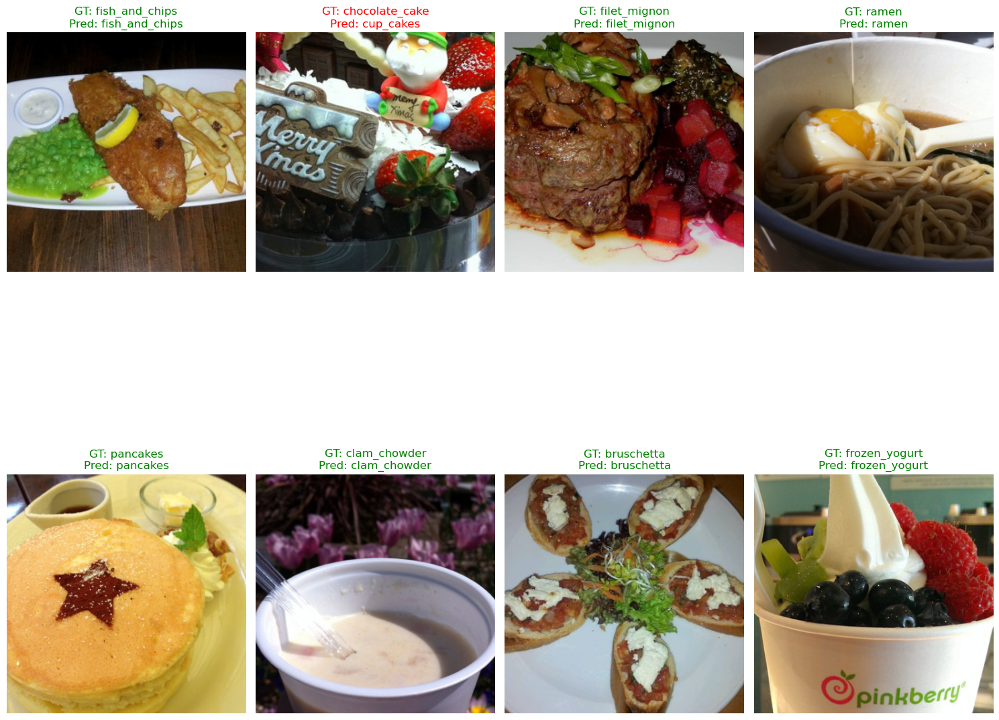

In [95]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # Undo normalization: img = img * std + mean
    # These are the values used in your transforms:
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])

    inp = inp.numpy().transpose((1, 2, 0)) # Convert from (C, H, W) to (H, W, C)
    inp = std * inp + mean # Denormalize
    inp = np.clip(inp, 0, 1) # Clip values to [0, 1] range for proper display
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off') # Turn off axes for cleaner image display

# Get a batch of test data
model.eval() # Set model to evaluation mode
dataiter = iter(test_loader)
images, labels = next(dataiter)

# Move images to the device for prediction
images = images.to(device)

# Make predictions
with torch.no_grad():
    outputs = model(images)
    _, predicted = torch.max(outputs, 1)

# Move tensors back to CPU for visualization
images = images.cpu()
labels = labels.cpu()
predicted = predicted.cpu()

# Plot the first N images from the batch
num_images_to_show = 8 # You can change this number
fig = plt.figure(figsize=(15, num_images_to_show * 2)) # Adjust figure size dynamically

for i in range(num_images_to_show):
    ax = fig.add_subplot(2, num_images_to_show // 2, i + 1, xticks=[], yticks=[])
    imshow(images[i])
    ground_truth_label = encoder.get_label(labels[i].item())
    predicted_label = encoder.get_label(predicted[i].item())

    # Set title color based on correctness
    color = "green" if ground_truth_label == predicted_label else "red"
    ax.set_title(f"GT: {ground_truth_label}\nPred: {predicted_label}", color=color)

plt.tight_layout()
plt.show()

<div class="alert alert-info" style="font-size:16px; line-height:1.6;">
  <h4><strong>Confusion Matrix Overview</strong></h4>
  <p>
    The <strong>confusion matrix</strong> provides a detailed breakdown of the model’s performance by showing how predictions are distributed across all 101 food classes.
    It highlights:
    <ul>
      <li><strong>True Positives</strong> (correct classifications on the diagonal)</li>
      <li><strong>Misclassifications</strong> (off-diagonal elements)</li>
      <li>Common confusion between visually similar food items</li>
    </ul>
  </p>
</div>

## ConvNeXt

<div class="alert alert-success">
<h4><strong>ConvNeXt-Base</strong></h4>
  <p>
    ConvNeXt-Base is a modern convolutional neural network architecture inspired by the design principles of Vision Transformers while retaining the efficiency of CNNs. It incorporates large kernel sizes, inverted bottlenecks, and LayerNorm to improve feature extraction and scalability, achieving state-of-the-art results on image classification benchmarks.
  </p>

  <h4><strong>Why Use ConvNeXt-Base?</strong></h4>

  <h5>Transformer-Inspired Enhancements</h5>
  <p>
    Combines CNN efficiency with architectural improvements from transformers, enabling better long-range feature modeling.
  </p>

  <h5>Strong Transfer Learning Performance</h5>
  <p>
    Pretrained on ImageNet and provides rich feature representations for downstream tasks like food classification.
  </p>

  <h5>Flexibility and Robustness</h5>
  <p>
    Suitable for fine-tuning with targeted layer freezing to balance adaptation and generalization.
    <ul>
      <li>Handles complex textures and shapes effectively</li>
      <li>Scalable to different dataset sizes</li>
      <li>Efficient inference speed</li>
    </ul>
  </p>

  <p>
    For these reasons, ConvNeXt-Base was chosen as one of the primary models for the Food-101 classification task.
  </p>
</div>


In [21]:
from torchvision.models import convnext_base, ConvNeXt_Base_Weights

# Loading pretrained ConvNeXt-Base
weights = ConvNeXt_Base_Weights.IMAGENET1K_V1
model = convnext_base(weights=weights)

# Freeze all layers
for param in model.parameters():
    param.requires_grad = False

# Unfreeze the last stage (features[7]) and classifier
# ConvNeXt has 8 stages in features (0-7), we'll unfreeze the last stage
for name, param in model.named_parameters():
    if 'features.7' in name or 'classifier' in name:
        param.requires_grad = True

# Replace final classification head
num_classes = len(classes)
# ConvNeXt classifier structure: [LayerNorm, Linear]
# We'll replace the Linear layer
in_features = model.classifier[2].in_features
model.classifier[2] = nn.Linear(in_features, num_classes)

# Move model to device (MPS)
model = model.to(device)

# Print summary (use input size [1, 3, 224, 224])
print("\nModel Summary:")
torchinfo.summary(model, input_size=(1, 3, 224, 224), device=device)


Model Summary:


Layer (type:depth-idx)                        Output Shape              Param #
ConvNeXt                                      [1, 101]                  --
├─Sequential: 1-1                             [1, 1024, 7, 7]           --
│    └─Conv2dNormActivation: 2-1              [1, 128, 56, 56]          --
│    │    └─Conv2d: 3-1                       [1, 128, 56, 56]          (6,272)
│    │    └─LayerNorm2d: 3-2                  [1, 128, 56, 56]          (256)
│    └─Sequential: 2-2                        [1, 128, 56, 56]          --
│    │    └─CNBlock: 3-3                      [1, 128, 56, 56]          (138,496)
│    │    └─CNBlock: 3-4                      [1, 128, 56, 56]          (138,496)
│    │    └─CNBlock: 3-5                      [1, 128, 56, 56]          (138,496)
│    └─Sequential: 2-3                        [1, 256, 28, 28]          --
│    │    └─LayerNorm2d: 3-6                  [1, 128, 56, 56]          (256)
│    │    └─Conv2d: 3-7                       [1, 256, 28, 28] 

#### Optimizer and Loss Function ####

<div class="alert alert-success">

**Optimizer and Loss Function**

- **Optimizer**:   
  - AdamW — selected for stable fine-tuning and effective regularization through weight decay.  
  - Initial Learning Rate: 5 × 10⁻⁴  
  - Weight Decay: 0.01

- **Loss Function**:  
  - CrossEntropyLoss — standard choice for multi-class classification.  
  - Encourages the model to predict correct class probabilities by penalizing incorrect predictions.

- **Epochs**: 10  
  - Selected to provide sufficient adaptation while minimizing overfitting.

- **Batch Size**: 32  
  - Balances computational efficiency and gradient stability.

</div>


In [41]:
# Filter parameters that require gradients
trainable_params = filter(lambda p: p.requires_grad, model.parameters())

# Define optimizer: AdamW is recommended for finetuning
optimizer = optim.AdamW(
    trainable_params,
    lr=5e-4,           
    weight_decay=1e-2  
)
loss_fn = nn.CrossEntropyLoss()

#### Early Stoppage

In [43]:
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
        self.best_model_state = None

    def __call__(self, val_loss, model):
        if self.best_loss is None or val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.best_model_state = model.state_dict()
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

#### Training Function ####

In [46]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs, early_stopping=None):
    model.to(device)
    best_val_loss = float('inf')

    print("\nStarting training...")
    for epoch in range(num_epochs):
        # Training Phase
        model.train()
        running_loss = 0.0
        correct_preds = 0
        total_samples = 0

        train_loop = tqdm(train_loader, leave=True, desc=f"Epoch {epoch+1}/{num_epochs} Train")

        for images, labels in train_loop:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            train_loop.set_postfix(loss=loss.item())

        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Train Accuracy: {epoch_acc:.4f}")

        # Validation Phase
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, labels)
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

        avg_val_loss = val_loss / val_total
        val_accuracy = val_correct / val_total
        print(f"[Epoch {epoch+1}/{num_epochs}] Val Loss: {avg_val_loss:.4f} | Val Accuracy: {val_accuracy:.4f}")

        # Early Stopping
        if early_stopping:
            early_stopping(avg_val_loss, model)
            if early_stopping.early_stop:
                print("Early stopping triggered.")
                break

    # Load best model weights after training
    if early_stopping and early_stopping.best_model_state:
        model.load_state_dict(early_stopping.best_model_state)
        print("Loaded best model weights from early stopping.")


#### Testing/Evaluation Function (with Per-Class Metrics) ####

In [48]:
def test_model(model, val_loader, loss_fn, device):
    model.eval() # Set model to evaluation mode
    total_loss = 0.0
    correct_preds = 0
    total_samples = 0

    all_predictions = []
    all_true_labels = []

    val_loop = tqdm(val_loader, leave=True, desc="Validation")

    with torch.no_grad(): # Disable gradient calculations during evaluation
        for images, labels in val_loop:
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = loss_fn(outputs, labels)

            total_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            # Collect predictions and true labels for per-class metrics
            all_predictions.extend(predicted.cpu().numpy())
            all_true_labels.extend(labels.cpu().numpy())

            val_loop.set_postfix(loss=loss.item())

    avg_loss = total_loss / total_samples
    accuracy = correct_preds / total_samples
    print(f"Validation Loss: {avg_loss:.4f} | Overall Accuracy: {accuracy:.4f}")

    # --- Calculate and print per-class metrics ---
    print("\n--- Per-Class Metrics ---")
    target_names = [encoder.get_label(i) for i in range(len(classes))]

    report = classification_report(all_true_labels, all_predictions, target_names=target_names, zero_division=0)
    print(report)

In [28]:
num_epochs = 10 # You can adjust this value
trained_model = train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs=num_epochs)
print("\nTraining complete!")  


Starting training...


Epoch 1/10 Train: 100%|██████████| 2131/2131 [35:13<00:00,  1.01it/s, loss=1.21]  


[Epoch 1/10] Train Loss: 1.8103 | Train Accuracy: 0.5567
[Epoch 1/10] Val Loss: 1.0006 | Val Accuracy: 0.7295


Epoch 2/10 Train: 100%|██████████| 2131/2131 [25:09<00:00,  1.41it/s, loss=0.837]


[Epoch 2/10] Train Loss: 1.3161 | Train Accuracy: 0.6608
[Epoch 2/10] Val Loss: 0.8882 | Val Accuracy: 0.7593


Epoch 3/10 Train: 100%|██████████| 2131/2131 [23:59<00:00,  1.48it/s, loss=0.882]


[Epoch 3/10] Train Loss: 1.2003 | Train Accuracy: 0.6879
[Epoch 3/10] Val Loss: 0.8329 | Val Accuracy: 0.7732


Epoch 4/10 Train: 100%|██████████| 2131/2131 [26:09<00:00,  1.36it/s, loss=0.925]


[Epoch 4/10] Train Loss: 1.1313 | Train Accuracy: 0.7035
[Epoch 4/10] Val Loss: 0.8091 | Val Accuracy: 0.7809


Epoch 5/10 Train: 100%|██████████| 2131/2131 [25:58<00:00,  1.37it/s, loss=1.91] 


[Epoch 5/10] Train Loss: 1.0750 | Train Accuracy: 0.7172
[Epoch 5/10] Val Loss: 0.7835 | Val Accuracy: 0.7900


Epoch 6/10 Train: 100%|██████████| 2131/2131 [25:44<00:00,  1.38it/s, loss=1.7]  


[Epoch 6/10] Train Loss: 1.0417 | Train Accuracy: 0.7233
[Epoch 6/10] Val Loss: 0.7644 | Val Accuracy: 0.7972


Epoch 7/10 Train: 100%|██████████| 2131/2131 [27:19<00:00,  1.30it/s, loss=1.28] 


[Epoch 7/10] Train Loss: 1.0033 | Train Accuracy: 0.7324
[Epoch 7/10] Val Loss: 0.7611 | Val Accuracy: 0.7978


Epoch 8/10 Train: 100%|██████████| 2131/2131 [32:07<00:00,  1.11it/s, loss=1.84] 


[Epoch 8/10] Train Loss: 0.9741 | Train Accuracy: 0.7387
[Epoch 8/10] Val Loss: 0.7640 | Val Accuracy: 0.7995


Epoch 9/10 Train: 100%|██████████| 2131/2131 [28:18<00:00,  1.25it/s, loss=0.567]


[Epoch 9/10] Train Loss: 0.9396 | Train Accuracy: 0.7472
[Epoch 9/10] Val Loss: 0.7606 | Val Accuracy: 0.8001


Epoch 10/10 Train: 100%|██████████| 2131/2131 [26:22<00:00,  1.35it/s, loss=0.572]


[Epoch 10/10] Train Loss: 0.9264 | Train Accuracy: 0.7500
[Epoch 10/10] Val Loss: 0.7493 | Val Accuracy: 0.8045

Training complete!


In [100]:
test_model(model, test_loader, loss_fn, device)
print("\nTraining complete!")

Validation: 100%|██████████| 790/790 [05:16<00:00,  2.50it/s, loss=0.302] 

Validation Loss: 0.5274 | Overall Accuracy: 0.8502

--- Per-Class Metrics ---
                         precision    recall  f1-score   support

              apple_pie       0.82      0.60      0.69       250
         baby_back_ribs       0.85      0.83      0.84       250
                baklava       0.89      0.91      0.90       250
         beef_carpaccio       0.78      0.93      0.85       250
           beef_tartare       0.88      0.77      0.82       250
             beet_salad       0.85      0.70      0.77       250
               beignets       0.84      0.94      0.89       250
               bibimbap       0.94      0.92      0.93       250
          bread_pudding       0.71      0.73      0.72       250
      breakfast_burrito       0.79      0.87      0.83       250
             bruschetta       0.85      0.76      0.80       250
           caesar_salad       0.82      0.91      0.87       250
                cannoli       0.91      0.92      0.92       250
          c

#### Saving the Model

In [ ]:
torch.save(model.state_dict(), 'food101_convnext_final.pth')

#### Loading the Model

In [77]:
from torchvision.models import convnext_base
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Rebuild architecture exactly as in training
model = convnext_base(weights=None)
model.classifier[2] = torch.nn.Linear(1024, 101)

# Load weights
state_dict = torch.load("food101_convnext_final.pth", map_location=device)
model.load_state_dict(state_dict)

model.to(device)
model.eval()


C:\Users\chola\AppData\Local\Temp\ipykernel_22600\2752411869.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("food101_convnext_final.pth", map_l

ConvNeXt(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(4, 4))
      (1): LayerNorm2d((128,), eps=1e-06, elementwise_affine=True)
    )
    (1): Sequential(
      (0): CNBlock(
        (block): Sequential(
          (0): Conv2d(128, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=128)
          (1): Permute()
          (2): LayerNorm((128,), eps=1e-06, elementwise_affine=True)
          (3): Linear(in_features=128, out_features=512, bias=True)
          (4): GELU(approximate='none')
          (5): Linear(in_features=512, out_features=128, bias=True)
          (6): Permute()
        )
        (stochastic_depth): StochasticDepth(p=0.0, mode=row)
      )
      (1): CNBlock(
        (block): Sequential(
          (0): Conv2d(128, 128, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), groups=128)
          (1): Permute()
          (2): LayerNorm((128,), eps=1e-06, elementwise_affine=True)
          (3): Linear(

### Results

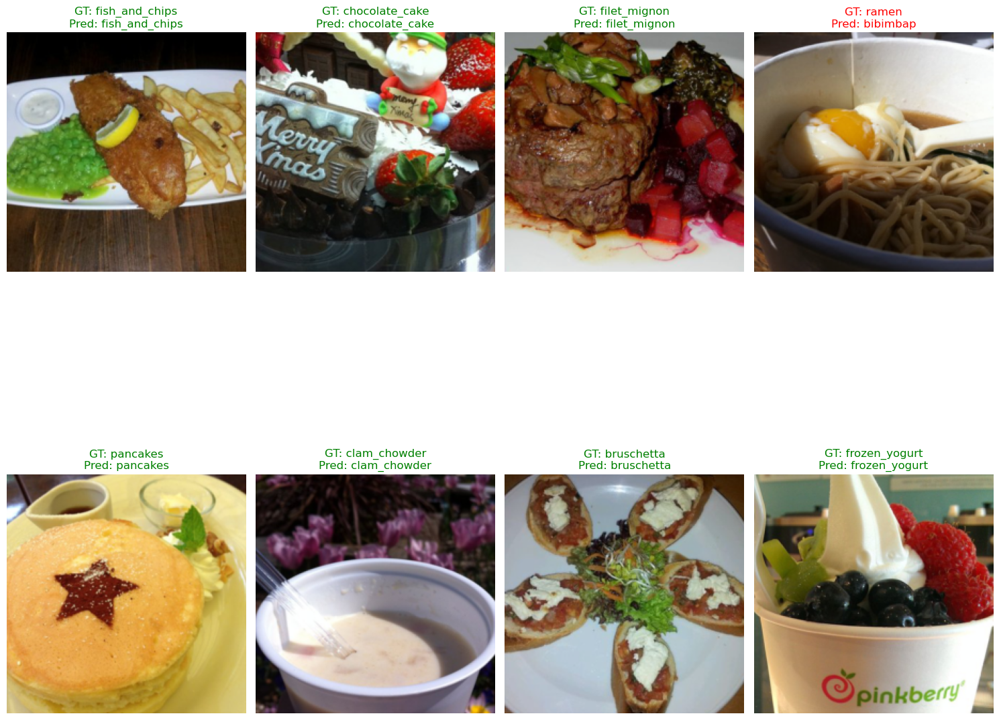

In [78]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # Undo normalization: img = img * std + mean
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])

    inp = inp.numpy().transpose((1, 2, 0)) # Convert from (C, H, W) to (H, W, C)
    inp = std * inp + mean # Denormalize
    inp = np.clip(inp, 0, 1) # Clip values to [0, 1] range for proper display
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off') # Turn off axes for cleaner image display

# Get a batch of test data
model.eval() # Set model to evaluation mode
dataiter = iter(test_loader)
images, labels = next(dataiter)

# Move images to the device for prediction
images = images.to(device)

# Make predictions
with torch.no_grad():
    outputs = model(images)
    _, predicted = torch.max(outputs, 1)

# Move tensors back to CPU for visualization
images = images.cpu()
labels = labels.cpu()
predicted = predicted.cpu()

# Plot the first N images from the batch
num_images_to_show = 8 # You can change this number
fig = plt.figure(figsize=(15, num_images_to_show * 2)) # Adjust figure size dynamically

for i in range(num_images_to_show):
    ax = fig.add_subplot(2, num_images_to_show // 2, i + 1, xticks=[], yticks=[])
    imshow(images[i])
    ground_truth_label = encoder.get_label(labels[i].item())
    predicted_label = encoder.get_label(predicted[i].item())

    # Set title color based on correctness
    color = "green" if ground_truth_label == predicted_label else "red"
    ax.set_title(f"GT: {ground_truth_label}\nPred: {predicted_label}", color=color)

plt.tight_layout()
plt.show()

<div class="alert alert-info" style="font-size:16px; line-height:1.6;">
  <h4><strong>Confusion Matrix Overview</strong></h4>
  <p>
    The <strong>confusion matrix</strong> provides a detailed breakdown of the model’s performance by showing how predictions are distributed across all 101 food classes.
    It highlights:
    <ul>
      <li><strong>True Positives</strong> (correct classifications on the diagonal)</li>
      <li><strong>Misclassifications</strong> (off-diagonal elements)</li>
      <li>Common confusion between visually similar food items</li>
    </ul>
  </p>
</div>


--- Generating Confusion Matrix ---


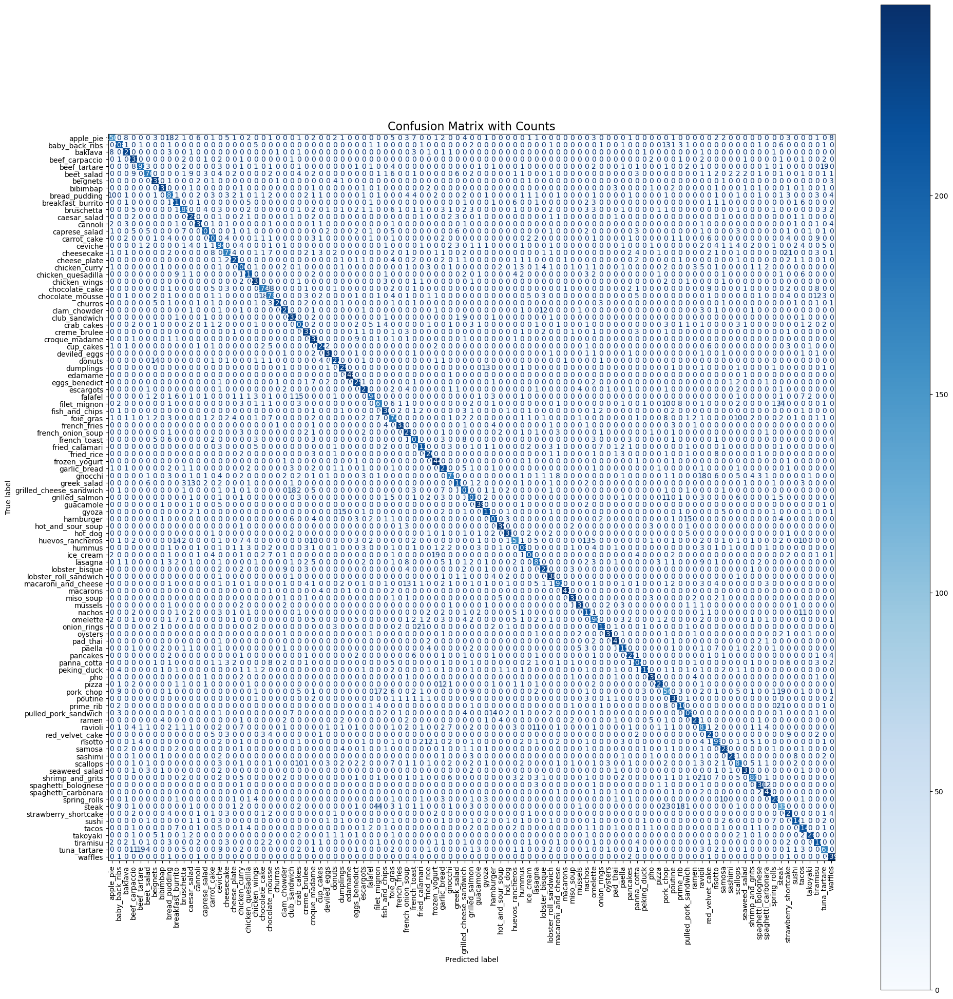

In [81]:
print("\n--- Generating Confusion Matrix ---")
cm = confusion_matrix(all_labels, all_predictions)

# Get class names
target_names = [encoder.get_label(i) for i in range(len(classes))]

fig, ax = plt.subplots(figsize=(20, 20))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)
disp.plot(include_values=True, xticks_rotation=90, ax=ax, cmap='Blues', colorbar=True)
plt.title("Confusion Matrix with Counts", fontsize=16)
plt.tight_layout()
plt.show()

#### Top Confused Classes

In [83]:
# Additional analysis: Top confused classes
print("\n--- Top 20 Most Confused Pairs ---")
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

confusion_pairs = []
for i in range(len(target_names)):
    for j in range(len(target_names)):
        if i != j and cm_no_diag[i, j] > 0:
            confusion_pairs.append((cm_no_diag[i, j], target_names[i], target_names[j]))

confusion_pairs.sort(reverse=True)
for count, true_label, pred_label in confusion_pairs[:20]:
    print(f"{true_label:20} -> {pred_label:20} : {count:3d} times")


--- Top 20 Most Confused Pairs ---
steak                -> filet_mignon         :  44 times
chocolate_cake       -> chocolate_mousse     :  38 times
filet_mignon         -> steak                :  34 times
steak                -> pork_chop            :  23 times
shrimp_and_grits     -> ravioli              :  21 times
prime_rib            -> steak                :  21 times
onion_rings          -> fried_calamari       :  21 times
cheesecake           -> strawberry_shortcake :  21 times
tuna_tartare         -> beef_tartare         :  19 times
pork_chop            -> steak                :  19 times
ice_cream            -> frozen_yogurt        :  19 times
beef_tartare         -> tuna_tartare         :  19 times
steak                -> prime_rib            :  18 times
grilled_cheese_sandwich -> club_sandwich        :  18 times
gnocchi              -> ravioli              :  18 times
chocolate_mousse     -> chocolate_cake       :  18 times
apple_pie            -> bread_pudding        :  1

#### Classwise Accuracy

In [84]:
# Per-class accuracy
print("\n--- Classes with Lowest Accuracy (Bottom 10) ---")
class_accuracy = []
for i in range(len(target_names)):
    total = cm[i].sum()
    if total > 0:
        accuracy = cm[i, i] / total
        class_accuracy.append((accuracy, target_names[i], total))

class_accuracy.sort()
for acc, class_name, total in class_accuracy[:10]:
    # Find the class index for this class name
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")

# Show classes with highest accuracy too
print("\n--- Classes with Highest Accuracy (Top 10) ---")
for acc, class_name, total in class_accuracy[-10:]:
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")


--- Classes with Lowest Accuracy (Bottom 10) ---
steak                : 0.540 (135/250 correct)
apple_pie            : 0.600 (150/250 correct)
pork_chop            : 0.624 (156/250 correct)
huevos_rancheros     : 0.628 (157/250 correct)
filet_mignon         : 0.668 (167/250 correct)
tuna_tartare         : 0.668 (167/250 correct)
cheesecake           : 0.688 (172/250 correct)
chocolate_cake       : 0.696 (174/250 correct)
foie_gras            : 0.696 (174/250 correct)
gnocchi              : 0.700 (175/250 correct)

--- Classes with Highest Accuracy (Top 10) ---
lobster_roll_sandwich : 0.952 (238/250 correct)
guacamole            : 0.956 (239/250 correct)
hot_and_sour_soup    : 0.956 (239/250 correct)
pho                  : 0.956 (239/250 correct)
waffles              : 0.956 (239/250 correct)
pad_thai             : 0.964 (241/250 correct)
macarons             : 0.968 (242/250 correct)
spaghetti_carbonara  : 0.968 (242/250 correct)
frozen_yogurt        : 0.976 (244/250 correct)
edamame 

#### Summary Metrics

In [80]:
# --- Summary Metrics ---
print("\n--- Summary Metrics ---")

overall_accuracy = accuracy_score(all_labels, all_predictions)
macro_precision = precision_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_recall = recall_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_f1 = f1_score(all_labels, all_predictions, average='macro', zero_division=0)

weighted_precision = precision_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_recall = recall_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_f1 = f1_score(all_labels, all_predictions, average='weighted', zero_division=0)

print(f"Overall Accuracy     : {overall_accuracy:.4f}")
print(f"Macro Precision      : {macro_precision:.4f}")
print(f"Macro Recall         : {macro_recall:.4f}")
print(f"Macro F1 Score       : {macro_f1:.4f}")
print(f"Weighted Precision   : {weighted_precision:.4f}")
print(f"Weighted Recall      : {weighted_recall:.4f}")
print(f"Weighted F1 Score    : {weighted_f1:.4f}")


--- Summary Metrics ---
Overall Accuracy     : 0.8502
Macro Precision      : 0.8526
Macro Recall         : 0.8502
Macro F1 Score       : 0.8497
Weighted Precision   : 0.8526
Weighted Recall      : 0.8502
Weighted F1 Score    : 0.8497


### Conclusion

<div class="alert alert-success">
    <h4><strong>EfficientNet-B4</strong></h4>
  <p>
    EfficientNet-B4 is a CNN architecture that scales network depth, width, and resolution in a balanced way using a compound scaling method. It employs depthwise separable convolutions and squeeze-and-excitation blocks to achieve high accuracy while keeping the parameter count relatively low.
  </p>
  <h4><strong>Why Use EfficientNet-B4?</strong></h4>

  <h5>Performance–Efficiency Balance</h5>
  <p>
    Achieves strong classification accuracy while keeping parameter count and computation low, making it ideal for large-scale datasets.
  </p>

  <h5>Feature Extraction</h5>
  <p>
    Learns both fine-grained and high-level image features effectively, crucial for differentiating similar food categories.
  </p>

  <h5>Transfer Learning Benefits</h5>
  <p>
    Utilizes pretrained weights from ImageNet to accelerate convergence and improve generalization.
    <ul>
      <li>Reduced training time</li>
      <li>Lower overfitting risk</li>
      <li>Better initial performance</li>
    </ul>
  </p>

  <p>
    For these reasons, EfficientNet-B4 was selected for the Food-101 dataset.
  </p>
</div>




--- Generating Confusion Matrix ---


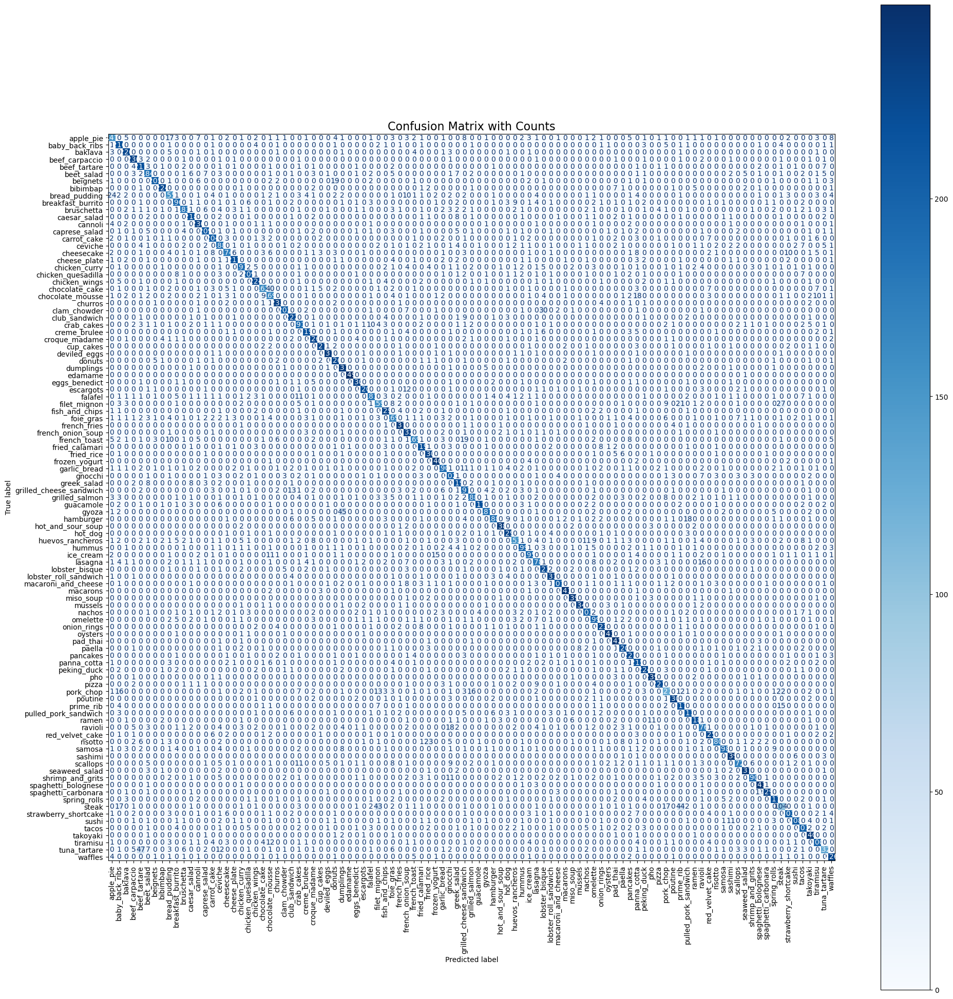

In [98]:
print("\n--- Generating Confusion Matrix ---")
cm = confusion_matrix(all_labels, all_predictions)

# Get class names
target_names = [encoder.get_label(i) for i in range(len(classes))]

# Plot confusion matrix with counts
fig, ax = plt.subplots(figsize=(20, 20))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)
disp.plot(include_values=True, xticks_rotation=90, ax=ax, cmap='Blues', colorbar=True)
plt.title("Confusion Matrix with Counts", fontsize=16)
plt.tight_layout()
plt.show()

#### Top Confused Classes

In [122]:
print("\n--- Top 20 Most Confused Pairs ---")
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

confusion_pairs = []
for i in range(len(target_names)):
    for j in range(len(target_names)):
        if i != j and cm_no_diag[i, j] > 0:
            confusion_pairs.append((cm_no_diag[i, j], target_names[i], target_names[j]))

confusion_pairs.sort(reverse=True)
for count, true_label, pred_label in confusion_pairs[:20]:
    print(f"{true_label:20} -> {pred_label:20} : {count:3d} times")


--- Top 20 Most Confused Pairs ---
tuna_tartare         -> beef_tartare         :  47 times
gyoza                -> dumplings            :  45 times
steak                -> prime_rib            :  44 times
steak                -> filet_mignon         :  43 times
chocolate_cake       -> chocolate_mousse     :  40 times
clam_chowder         -> lobster_bisque       :  30 times
filet_mignon         -> steak                :  27 times
bread_pudding        -> apple_pie            :  24 times
risotto              -> fried_rice           :  23 times
pork_chop            -> steak                :  22 times
filet_mignon         -> prime_rib            :  21 times
french_toast         -> grilled_cheese_sandwich :  19 times
beignets             -> donuts               :  19 times
ravioli              -> gnocchi              :  18 times
hamburger            -> pulled_pork_sandwich :  18 times
chocolate_mousse     -> panna_cotta          :  18 times
steak                -> pork_chop            :  1

#### Classwise Accuracy

In [101]:
# Per-class accuracy
print("\n--- Classes with Lowest Accuracy (Bottom 10) ---")
class_accuracy = []
for i in range(len(target_names)):
    total = cm[i].sum()
    if total > 0:
        accuracy = cm[i, i] / total
        class_accuracy.append((accuracy, target_names[i], total))

class_accuracy.sort()
for acc, class_name, total in class_accuracy[:10]:
    # Find the class index for this class name
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")

# Show classes with highest accuracy too
print("\n--- Classes with Highest Accuracy (Top 10) ---")
for acc, class_name, total in class_accuracy[-10:]:
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")


--- Classes with Lowest Accuracy (Bottom 10) ---
steak                : 0.416 (104/250 correct)
pork_chop            : 0.508 (127/250 correct)
tuna_tartare         : 0.528 (132/250 correct)
apple_pie            : 0.588 (147/250 correct)
huevos_rancheros     : 0.612 (153/250 correct)
bread_pudding        : 0.620 (155/250 correct)
filet_mignon         : 0.636 (159/250 correct)
chocolate_cake       : 0.648 (162/250 correct)
chocolate_mousse     : 0.676 (169/250 correct)
foie_gras            : 0.676 (169/250 correct)

--- Classes with Highest Accuracy (Top 10) ---
miso_soup            : 0.956 (239/250 correct)
pho                  : 0.956 (239/250 correct)
sashimi              : 0.956 (239/250 correct)
frozen_yogurt        : 0.960 (240/250 correct)
takoyaki             : 0.960 (240/250 correct)
macarons             : 0.964 (241/250 correct)
oysters              : 0.964 (241/250 correct)
spaghetti_bolognese  : 0.964 (241/250 correct)
pad_thai             : 0.968 (242/250 correct)
edamame  

#### Summary Metrics

In [97]:
# --- Summary Metrics ---
print("\n--- Summary Metrics ---")

overall_accuracy = accuracy_score(all_labels, all_predictions)
macro_precision = precision_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_recall = recall_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_f1 = f1_score(all_labels, all_predictions, average='macro', zero_division=0)

weighted_precision = precision_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_recall = recall_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_f1 = f1_score(all_labels, all_predictions, average='weighted', zero_division=0)

print(f"Overall Accuracy     : {overall_accuracy:.4f}")
print(f"Macro Precision      : {macro_precision:.4f}")
print(f"Macro Recall         : {macro_recall:.4f}")
print(f"Macro F1 Score       : {macro_f1:.4f}")
print(f"Weighted Precision   : {weighted_precision:.4f}")
print(f"Weighted Recall      : {weighted_recall:.4f}")
print(f"Weighted F1 Score    : {weighted_f1:.4f}")


--- Summary Metrics ---
Overall Accuracy     : 0.8312
Macro Precision      : 0.8327
Macro Recall         : 0.8312
Macro F1 Score       : 0.8294
Weighted Precision   : 0.8327
Weighted Recall      : 0.8312
Weighted F1 Score    : 0.8294


## Hybrid Model - EfficientNet + ConvNeXt

<div class="alert alert-success">
<h4><strong>Hybrid EfficientNet + ConvNeXt</strong></h4>
  <p>
    The hybrid model integrates the feature extraction capabilities of EfficientNet-B4 and ConvNeXt-Base, combining their complementary strengths. 
    Both backbones are pretrained, and their original classification heads are removed. 
    Extracted feature maps are scaled by learnable weights and concatenated before passing through a custom classifier with fully connected layers, batch normalization, ReLU activation, and dropout. 
    This design enables dynamic feature fusion for enhanced representation learning.
  </p>

  <h4><strong>Why Use this Hybrid EfficientNet + ConvNeXt?</strong></h4>

  <h5>Complementary Feature Extraction</h5>
  <p>
    EfficientNet excels in efficient scaling and detail capture, while ConvNeXt provides robust high-level semantic understanding.
  </p>

  <h5>Adaptive Fusion</h5>
  <p>
    Learnable weights allow the model to adaptively balance each backbone's contribution for optimal classification.
  </p>

  <h5>Improved Generalization</h5>
  <p>
    <ul>
      <li>Diverse features from two architectures enhance representation richness</li>
      <li>Batch normalization and dropout mitigate overfitting</li>
      <li>Selective fine-tuning preserves pretrained knowledge while adapting to Food-101</li>
    </ul>
  </p>

  <p>
    For these reasons, the hybrid model achieves superior accuracy compared to using either backbone alone.
  </p>
</div>


### Image Transforms

<div class="alert alert-success">
<h4><strong>Why These Transforms Work Best for the Hybrid EfficientNet-B4 + ConvNeXt Model</strong></h4>
 
  <h5>Shared Compatibility with Pretrained Backbones</h5>
<p>
    Both <strong>EfficientNet-B4</strong> and <strong>ConvNeXt</strong> were pretrained on ImageNet with normalization
    parameters (<code>mean=[0.485, 0.456, 0.406]</code>, <code>std=[0.229, 0.224, 0.225]</code>).  
    By using <code>RandomResizedCrop(380)</code> for training and <code>CenterCrop(380)</code> for testing,
    the transforms ensure <strong>consistent input size</strong> and <strong>pixel value distribution</strong> across both branches,
    allowing the hybrid model to fully leverage the rich pretrained features.
</p>
 
  <h5>Robust Generalization for Dual-Stream Features</h5>
<p>
    The augmentation strategy (<code>RandomHorizontalFlip(p=0.5)</code> with crop/resize) injects <strong>natural variability</strong>
    without distorting object geometry, which is crucial when combining outputs from two architectures.  
    For evaluation, <code>Resize(438) → CenterCrop(380)</code> follows the <strong>standard ImageNet testing protocol</strong>,
    ensuring both EfficientNet-B4 and ConvNeXt receive <strong>uniform, artifact-free inputs</strong> for stable ensemble-like performance.
</p>
</div>

In [24]:
# Training transforms
train_transforms = transforms.Compose([
    transforms.RandomResizedCrop(380),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transforms = transforms.Compose([
    transforms.Resize(438),  # Resize to slightly larger
    transforms.CenterCrop(380),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

#### Optimizer and Loss Function ####

<div class="alert alert-success">

**Optimizer and Loss Function**

- **Optimizer**:   
  - AdamW — chosen for stable fine-tuning and effective weight decay regularization.  
  - Initial Learning Rate: 5 × 10⁻⁴  
  - Weight Decay: 0.05 (higher to improve generalization)

- **Loss Function**:  
  - CrossEntropyLoss with label smoothing (0.1) to reduce overconfidence in predictions.  
  - Helps improve calibration and robustness.

- **Epochs**: 20  
  - Selected to allow sufficient fine-tuning while minimizing overfitting risk.

- **Batch Size**: 32  

</div>


In [32]:
# Filter parameters that require gradients
trainable_params = filter(lambda p: p.requires_grad, model.parameters())

# Define optimizer: AdamW is recommended for finetuning
optimizer = optim.AdamW(
    filter(lambda p: p.requires_grad, model.parameters()),
    lr=5e-4,
    weight_decay=5e-2,  # Higher weight decay
    betas=(0.9, 0.999)
)

# Replace loss function
loss_fn = nn.CrossEntropyLoss(label_smoothing=0.1)

#### Training Function ####

In [27]:
def train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs):
    model.to(device)
    best_val_loss = float('inf')

    print("\nStarting training...")
    for epoch in range(num_epochs):
        # Training Phase
        model.train()
        running_loss = 0.0
        correct_preds = 0
        total_samples = 0

        train_loop = tqdm(train_loader, leave=True, desc=f"Epoch {epoch+1}/{num_epochs} Train")

        for images, labels in train_loop:
            images, labels = images.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            train_loop.set_postfix(loss=loss.item())
  
        epoch_loss = running_loss / total_samples
        epoch_acc = correct_preds / total_samples
        print(f"[Epoch {epoch+1}/{num_epochs}] Train Loss: {epoch_loss:.4f} | Train Accuracy: {epoch_acc:.4f}")

        # Validation Phase
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, labels)
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_correct += (predicted == labels).sum().item()
                val_total += labels.size(0)

        avg_val_loss = val_loss / val_total
        val_accuracy = val_correct / val_total
        print(f"[Epoch {epoch+1}/{num_epochs}] Val Loss: {avg_val_loss:.4f} | Val Accuracy: {val_accuracy:.4f}")


#### Testing/Evaluation Function (with Per-Class Metrics) ####

In [29]:
def test_model(model, val_loader, loss_fn, device):
    model.eval() # Set model to evaluation mode
    total_loss = 0.0
    correct_preds = 0
    total_samples = 0

    all_predictions = []
    all_true_labels = []

    val_loop = tqdm(val_loader, leave=True, desc="Validation")

    with torch.no_grad(): # Disable gradient calculations during evaluation
        for images, labels in val_loop:
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = loss_fn(outputs, labels)

            total_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            correct_preds += (predicted == labels).sum().item()
            total_samples += labels.size(0)

            # Collect predictions and true labels for per-class metrics
            all_predictions.extend(predicted.cpu().numpy())
            all_true_labels.extend(labels.cpu().numpy())

            val_loop.set_postfix(loss=loss.item())

    avg_loss = total_loss / total_samples
    accuracy = correct_preds / total_samples
    print(f"Validation Loss: {avg_loss:.4f} | Overall Accuracy: {accuracy:.4f}")

    # --- Calculate and print per-class metrics ---
    print("\n--- Per-Class Metrics ---")
    target_names = [encoder.get_label(i) for i in range(len(classes))]

    report = classification_report(all_true_labels, all_predictions, target_names=target_names, zero_division=0)
    print(report)

In [30]:
num_epochs = 10 # You can adjust this value
trained_model = train_model(model, train_loader, val_loader, optimizer, loss_fn, device, num_epochs=num_epochs)

print("\nTraining complete!")


Starting training...


Epoch 1/10 Train: 100%|██████████| 2131/2131 [1:52:45<00:00,  3.18s/it, loss=2.93]


[Epoch 1/10] Train Loss: 2.3840 | Train Accuracy: 0.5466
[Epoch 1/10] Val Loss: 1.6276 | Val Accuracy: 0.7620


Epoch 2/10 Train: 100%|██████████| 2131/2131 [1:44:47<00:00,  2.95s/it, loss=1.78]


[Epoch 2/10] Train Loss: 1.9735 | Train Accuracy: 0.6583
[Epoch 2/10] Val Loss: 1.5169 | Val Accuracy: 0.7972


Epoch 3/10 Train: 100%|██████████| 2131/2131 [1:47:06<00:00,  3.02s/it, loss=2.35]


[Epoch 3/10] Train Loss: 1.8530 | Train Accuracy: 0.6956
[Epoch 3/10] Val Loss: 1.4726 | Val Accuracy: 0.8063


Epoch 4/10 Train: 100%|██████████| 2131/2131 [1:40:49<00:00,  2.84s/it, loss=2.55]


[Epoch 4/10] Train Loss: 1.7787 | Train Accuracy: 0.7173
[Epoch 4/10] Val Loss: 1.4217 | Val Accuracy: 0.8206


Epoch 5/10 Train: 100%|██████████| 2131/2131 [1:40:54<00:00,  2.84s/it, loss=1.46]


[Epoch 5/10] Train Loss: 1.7193 | Train Accuracy: 0.7347
[Epoch 5/10] Val Loss: 1.4165 | Val Accuracy: 0.8161


Epoch 6/10 Train: 100%|██████████| 2131/2131 [1:41:02<00:00,  2.84s/it, loss=1.93]


[Epoch 6/10] Train Loss: 1.6806 | Train Accuracy: 0.7444
[Epoch 6/10] Val Loss: 1.4029 | Val Accuracy: 0.8220


Epoch 7/10 Train: 100%|██████████| 2131/2131 [1:43:34<00:00,  2.92s/it, loss=2.04]  


[Epoch 7/10] Train Loss: 1.6467 | Train Accuracy: 0.7550
[Epoch 7/10] Val Loss: 1.3825 | Val Accuracy: 0.8272


Epoch 8/10 Train: 100%|██████████| 2131/2131 [1:46:34<00:00,  3.00s/it, loss=1.46]


[Epoch 8/10] Train Loss: 1.6185 | Train Accuracy: 0.7628
[Epoch 8/10] Val Loss: 1.3722 | Val Accuracy: 0.8259


Epoch 9/10 Train: 100%|██████████| 2131/2131 [2:07:14<00:00,  3.58s/it, loss=1.57]  


[Epoch 9/10] Train Loss: 1.5922 | Train Accuracy: 0.7697
[Epoch 9/10] Val Loss: 1.3920 | Val Accuracy: 0.8232


Epoch 10/10 Train: 100%|██████████| 2131/2131 [2:14:19<00:00,  3.78s/it, loss=1.84]  


[Epoch 10/10] Train Loss: 1.5862 | Train Accuracy: 0.7727
[Epoch 10/10] Val Loss: 1.3774 | Val Accuracy: 0.8284

Training complete!


In [42]:
test_model(model, test_loader, loss_fn, device)
print("\nTraining complete!")

Validation: 100%|██████████| 790/790 [36:15<00:00,  2.75s/it, loss=0.932]

Validation Loss: 1.2234 | Overall Accuracy: 0.8693

--- Per-Class Metrics ---
                         precision    recall  f1-score   support

              apple_pie       0.79      0.63      0.70       250
         baby_back_ribs       0.86      0.87      0.87       250
                baklava       0.86      0.92      0.89       250
         beef_carpaccio       0.95      0.86      0.90       250
           beef_tartare       0.76      0.91      0.83       250
             beet_salad       0.92      0.73      0.81       250
               beignets       0.93      0.89      0.91       250
               bibimbap       0.94      0.96      0.95       250
          bread_pudding       0.66      0.73      0.69       250
      breakfast_burrito       0.81      0.88      0.85       250
             bruschetta       0.86      0.80      0.83       250
           caesar_salad       0.89      0.93      0.91       250
                cannoli       0.93      0.92      0.93       250
          c

#### Saving the Model

In [ ]:
torch.save(model.state_dict(), 'food101_hybrid_EfficientNet_ConvNeXt.pth')

#### Loading the Model

In [41]:
model = HybridEfficientNetConvNeXt(num_classes=len(classes))
model = model.to(device)

state_dict = torch.load("food101_hybrid_EfficientNet_ConvNeXt.pth", map_location=device)
model.load_state_dict(state_dict)

model.eval()

C:\Users\Yatindran Sathish\AppData\Local\Temp\ipykernel_22356\2307213127.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("food101_hybrid_Efficien

HybridEfficientNetConvNeXt(
  (efficientnet): EfficientNet(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU(inplace=True)
      )
      (1): Sequential(
        (0): MBConv(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=48, bias=False)
              (1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): SiLU(inplace=True)
            )
            (1): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(48, 12, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(12, 48, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)


### Results

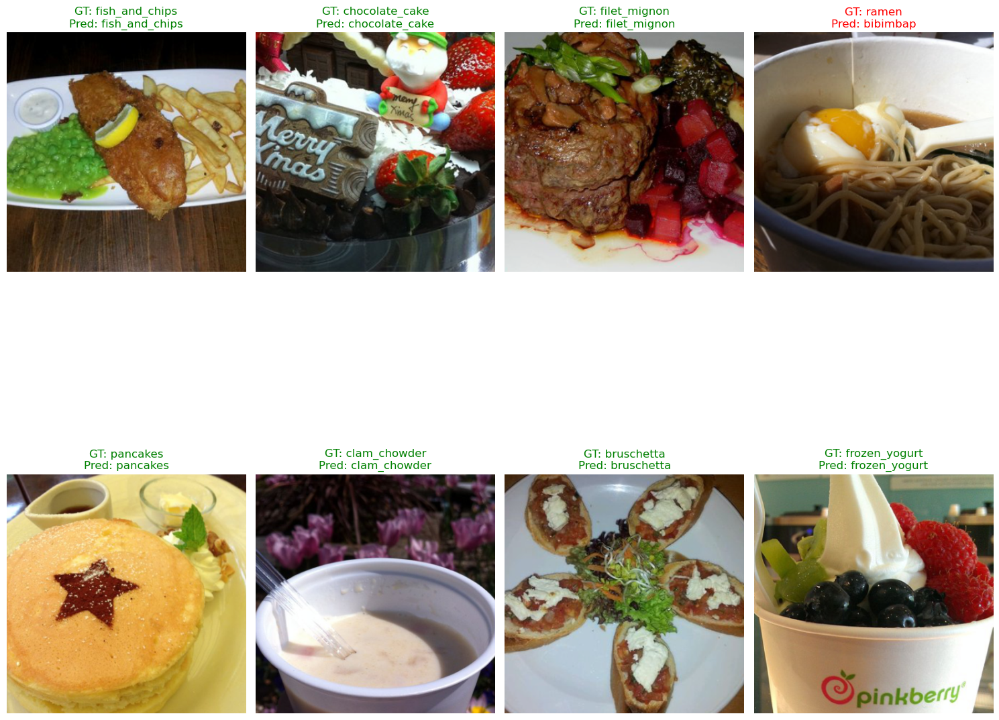

In [33]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # Undo normalization: img = img * std + mean
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])

    inp = inp.numpy().transpose((1, 2, 0)) # Convert from (C, H, W) to (H, W, C)
    inp = std * inp + mean # Denormalize
    inp = np.clip(inp, 0, 1) # Clip values to [0, 1] range for proper display
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off') # Turn off axes for cleaner image display

# Get a batch of test data
model.eval() # Set model to evaluation mode
dataiter = iter(test_loader)
images, labels = next(dataiter)

# Move images to the device for prediction
images = images.to(device)

# Make predictions
with torch.no_grad():
    outputs = model(images)
    _, predicted = torch.max(outputs, 1)

# Move tensors back to CPU for visualization
images = images.cpu()
labels = labels.cpu()
predicted = predicted.cpu()

# Plot the first N images from the batch
num_images_to_show = 8 # You can change this number
fig = plt.figure(figsize=(15, num_images_to_show * 2)) # Adjust figure size dynamically

for i in range(num_images_to_show):
    ax = fig.add_subplot(2, num_images_to_show // 2, i + 1, xticks=[], yticks=[])
    imshow(images[i])
    ground_truth_label = encoder.get_label(labels[i].item())
    predicted_label = encoder.get_label(predicted[i].item())

    # Set title color based on correctness
    color = "green" if ground_truth_label == predicted_label else "red"
    ax.set_title(f"GT: {ground_truth_label}\nPred: {predicted_label}", color=color)

plt.tight_layout()
plt.show()

<div class="alert alert-info" style="font-size:16px; line-height:1.6;">
  <h4><strong>Confusion Matrix Overview</strong></h4>
  <p>
    The <strong>confusion matrix</strong> provides a detailed breakdown of the model’s performance by showing how predictions are distributed across all 101 food classes.
    It highlights:
    <ul>
      <li><strong>True Positives</strong> (correct classifications on the diagonal)</li>
      <li><strong>Misclassifications</strong> (off-diagonal elements)</li>
      <li>Common confusion between visually similar food items</li>
    </ul>
  </p>
</div>


--- Generating Confusion Matrix ---


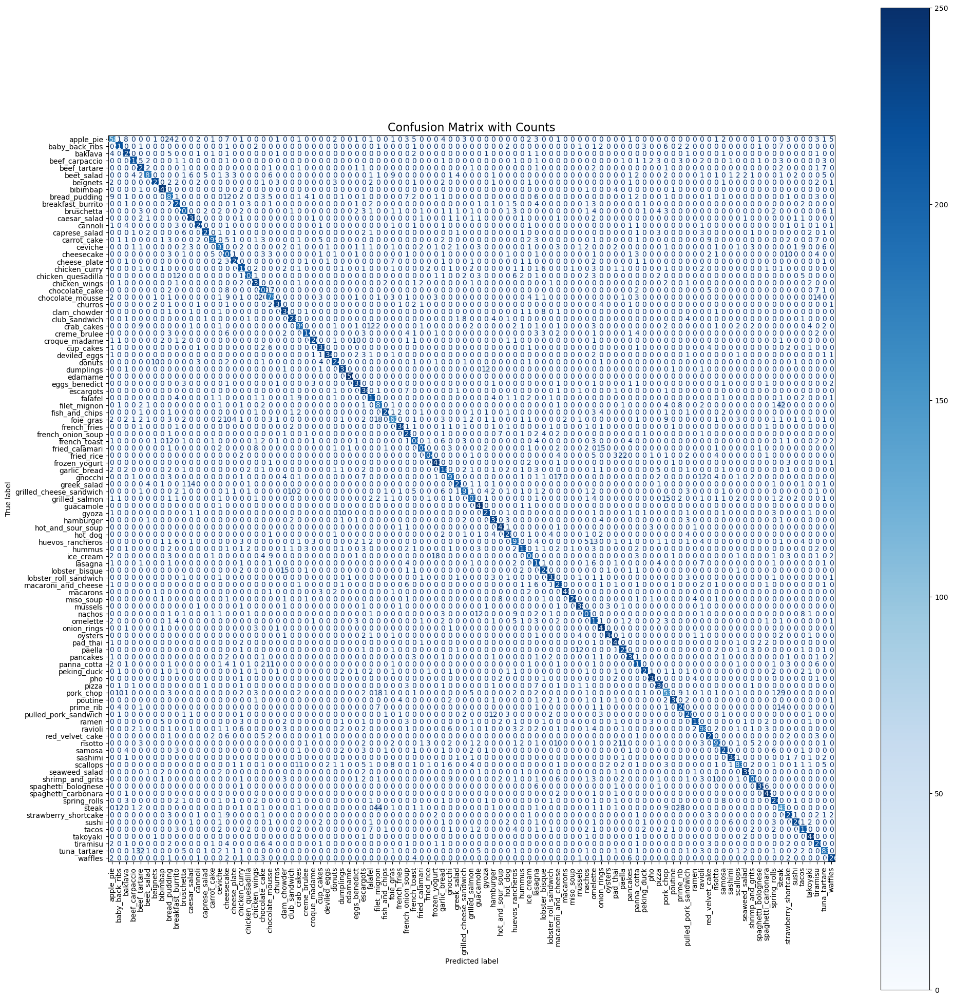

In [75]:
print("\n--- Generating Confusion Matrix ---")
cm = confusion_matrix(all_labels, all_predictions)

# Get class names
target_names = [encoder.get_label(i) for i in range(len(classes))]

fig, ax = plt.subplots(figsize=(20, 20))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)
disp.plot(include_values=True, xticks_rotation=90, ax=ax, cmap='Blues', colorbar=True)
plt.title("Confusion Matrix with Counts", fontsize=16)
plt.tight_layout()
plt.show()

#### Top Confused Classes

In [78]:
print("\n--- Top 20 Most Confused Pairs ---")
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

confusion_pairs = []
for i in range(len(target_names)):
    for j in range(len(target_names)):
        if i != j and cm_no_diag[i, j] > 0:
            confusion_pairs.append((cm_no_diag[i, j], target_names[i], target_names[j]))

confusion_pairs.sort(reverse=True)
for count, true_label, pred_label in confusion_pairs[:20]:
    print(f"{true_label:20} -> {pred_label:20} : {count:3d} times")


--- Top 20 Most Confused Pairs ---
steak                -> filet_mignon         :  44 times
filet_mignon         -> steak                :  42 times
tuna_tartare         -> beef_tartare         :  32 times
pork_chop            -> steak                :  29 times
steak                -> prime_rib            :  28 times
apple_pie            -> bread_pudding        :  24 times
fried_rice           -> paella               :  22 times
chocolate_mousse     -> chocolate_cake       :  20 times
pork_chop            -> filet_mignon         :  18 times
ice_cream            -> frozen_yogurt        :  18 times
foie_gras            -> filet_mignon         :  18 times
gnocchi              -> macaroni_and_cheese  :  17 times
chocolate_cake       -> chocolate_mousse     :  17 times
lobster_bisque       -> clam_chowder         :  15 times
grilled_salmon       -> pork_chop            :  15 times
fried_calamari       -> onion_rings          :  15 times
prime_rib            -> steak                :  14 t

#### Classwise Accuracy

In [79]:
# Per-class accuracy
print("\n--- Classes with Lowest Accuracy (Bottom 10) ---")
class_accuracy = []
for i in range(len(target_names)):
    total = cm[i].sum()
    if total > 0:
        accuracy = cm[i, i] / total
        class_accuracy.append((accuracy, target_names[i], total))

class_accuracy.sort()
for acc, class_name, total in class_accuracy[:10]:
    # Find the class index for this class name
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")

# Show classes with highest accuracy too
print("\n--- Classes with Highest Accuracy (Top 10) ---")
for acc, class_name, total in class_accuracy[-10:]:
    class_idx = np.where(np.array(target_names) == class_name)[0][0]
    correct_predictions = cm[class_idx, class_idx]
    print(f"{class_name:20} : {acc:.3f} ({correct_predictions}/{total} correct)")


--- Classes with Lowest Accuracy (Bottom 10) ---
steak                : 0.572 (143/250 correct)
pork_chop            : 0.612 (153/250 correct)
apple_pie            : 0.632 (158/250 correct)
foie_gras            : 0.648 (162/250 correct)
chocolate_mousse     : 0.716 (179/250 correct)
beet_salad           : 0.724 (181/250 correct)
filet_mignon         : 0.724 (181/250 correct)
bread_pudding        : 0.728 (182/250 correct)
scallops             : 0.732 (183/250 correct)
tuna_tartare         : 0.732 (183/250 correct)

--- Classes with Highest Accuracy (Top 10) ---
macarons             : 0.960 (240/250 correct)
pad_thai             : 0.960 (240/250 correct)
bibimbap             : 0.964 (241/250 correct)
frozen_yogurt        : 0.964 (241/250 correct)
hot_and_sour_soup    : 0.968 (242/250 correct)
onion_rings          : 0.972 (243/250 correct)
takoyaki             : 0.976 (244/250 correct)
spaghetti_carbonara  : 0.980 (245/250 correct)
guacamole            : 0.988 (247/250 correct)
edamame  

#### Summary Metrics

In [74]:
# --- Summary Metrics ---
print("\n--- Summary Metrics ---")

overall_accuracy = accuracy_score(all_labels, all_predictions)
macro_precision = precision_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_recall = recall_score(all_labels, all_predictions, average='macro', zero_division=0)
macro_f1 = f1_score(all_labels, all_predictions, average='macro', zero_division=0)

weighted_precision = precision_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_recall = recall_score(all_labels, all_predictions, average='weighted', zero_division=0)
weighted_f1 = f1_score(all_labels, all_predictions, average='weighted', zero_division=0)

print(f"Overall Accuracy     : {overall_accuracy:.4f}")
print(f"Macro Precision      : {macro_precision:.4f}")
print(f"Macro Recall         : {macro_recall:.4f}")
print(f"Macro F1 Score       : {macro_f1:.4f}")
print(f"Weighted Precision   : {weighted_precision:.4f}")
print(f"Weighted Recall      : {weighted_recall:.4f}")
print(f"Weighted F1 Score    : {weighted_f1:.4f}")


--- Summary Metrics ---
Overall Accuracy     : 0.8691
Macro Precision      : 0.8723
Macro Recall         : 0.8691
Macro F1 Score       : 0.8691
Weighted Precision   : 0.8723
Weighted Recall      : 0.8691
Weighted F1 Score    : 0.8691


## Conclusion

<div class="alert alert-info" style="font-size: 16px; line-height: 1.6;">

<b>Resource vs Time vs Performance:</b><br>
- Striking a balance between <b>training time, resource usage,</b> and <b>performance</b> proved to be challenging.<br>

<b>ResNet50, EfficientNet, ConvNeXt</b><br>
- Delivered strong performance across all **7 evaluation metrics**. <br>
- Much faster training (~**3 hours** for 10 epochs).

<b>ResNet50 + ViT:</b><br>
- Achieved **top scores** across all metrics and classified all test images correctly.
- Training was slow (~**10 hours** for 10 epochs) due to heavy backbones.


<b>Convnext + EfficientNet:</b><br>
- Matched **ResNet50 + ViT** in performance.
- Also required **~10 hours** for 10 epochs.

**Overall:**  
- **ResNet50 + ViT** and **ConvNeXt + EfficientNet** offer the best results.  
- For faster iteration with minimal performance drop, **ResNet50** or **EfficientNet** alone are more **resource-efficient** choices.

</div>